## Sentiment Analysis

### Load Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 

In [3]:
from sklearn.feature_extraction.text import CountVectorizer
count=CountVectorizer()

### Load Dataset

In [4]:
data=pd.read_csv("./data.csv")
data.head()

,text,label
0,I grew up (b. 1965) watching and loving the Th...,0
1,"When I put this movie in my DVD player, and sa...",0
2,Why do people who do not know what a particula...,0
3,Even though I have great interest in Biblical ...,0
4,Im a die hard Dads Army fan and nothing will e...,1


### Data Structure

In [5]:
data.shape

(40000, 2)

In [18]:
data.describe()

,label
count,40000.000000
mean,0.499525
std,0.500006
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


### Data Pre-processing

In [9]:
data.isnull().values.any()

False

### Visualize the distribution of the data

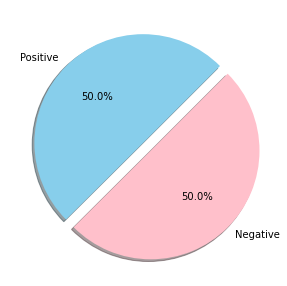

In [10]:
fig=plt.figure(figsize=(5,5))
colors=["skyblue",'pink']
pos=data[data['label']==1]
neg=data[data['label']==0]
ck=[pos['label'].count(),neg['label'].count()]
legpie=plt.pie(ck,labels=["Positive","Negative"],
                 autopct ='%1.1f%%', 
                 shadow = True,
                 colors = colors,
                 startangle = 45,
                 explode=(0, 0.1))

In [11]:
import re
def preprocessor(text):
             text=re.sub('<[^>]*>','',text)
             emojis=re.findall('(?::|;|=)(?:-)?(?:\)|\(|D|P)',text)
             text=re.sub('[\W]+',' ',text.lower()) +\
                ' '.join(emojis).replace('-','')
             return text   
data['text']=data['text'].apply(preprocessor)

In [12]:
from nltk.stem.porter import PorterStemmer
porter=PorterStemmer()
def tokenizer(text):
        return text.split()
def tokenizer_porter(text):
    return [porter.stem(word) for word in text.split()]

### Visualizing Negative and Positive Words

Positive words are as follows


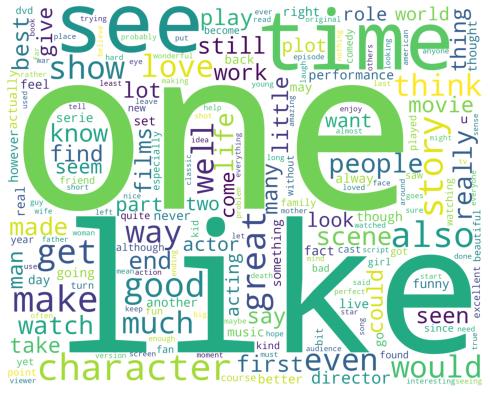

Negative words are as follows


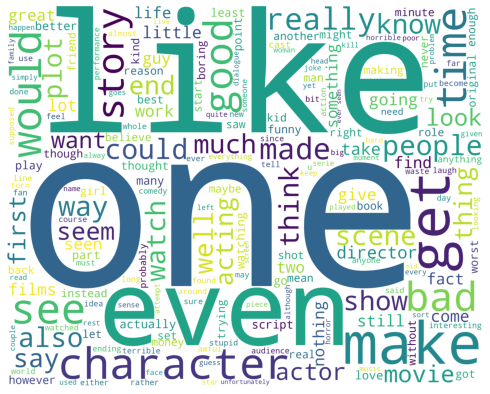

In [14]:
from nltk.corpus import stopwords
stop=stopwords.words('english')

from wordcloud import WordCloud
positivedata = data[ data['label'] == 1]
positivedata =positivedata['text']
negdata = data[data['label'] == 0]
negdata= negdata['text']

def wordcloud_draw(data, color = 'white'):
    words = ' '.join(data)
    cleaned_word = " ".join([word for word in words.split()
                              if(word!='movie' and word!='film')
                            ])
    wordcloud = WordCloud(stopwords=stop,
                      background_color=color,
                      width=2500,
                      height=2000
                     ).generate(cleaned_word)
    plt.figure(1,figsize=(10, 7))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()
    
print("Positive words are as follows")
wordcloud_draw(positivedata,'white')
print("Negative words are as follows")
wordcloud_draw(negdata)

In [16]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf=TfidfVectorizer(strip_accents=None,lowercase=False,preprocessor=None,tokenizer=tokenizer_porter,use_idf=True,norm='l2',smooth_idf=True)
y=data.label.values
x=tfidf.fit_transform(data.text)

### Split the dataset in test and train

In [17]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(x,y,random_state=1,test_size=0.5,shuffle=False)

### Fit the model

In [19]:
from sklearn.linear_model import LogisticRegressionCV
clf=LogisticRegressionCV(cv=6,scoring='accuracy',random_state=0,n_jobs=-1,verbose=3,max_iter=500).fit(X_train,y_train)
y_pred = clf.predict(X_test)
from sklearn import metrics

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10
 This problem is unconstrained.

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.15527D+04    |proj g|=  7.76886D+01


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in this segment
Piece      1 --f1, f2 at start point  -1.0578D+05  1.0578D+05
Distance to the stationary point =   1.0000D+00

---------------- exit CAUCHY----------------------

       66596  variables are free at GCP            1
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10
 This problem is unconstrained.

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.15527D+04    |proj g|=  7.78829D+01


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in t

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      8.0486D-04  0.0000D+00 -3.4035D-03 -5.4015D-04 -6.9168D-04 -1.3813D-03
     -5.4794D-04  3.4473D-03  0.0000D+00  1.0259D-04 -1.1771D-03  0.0000D+00
     -1.5128D-05  3.8705D-04  5.7207D-04 -1.1174D-03  1.3294D-03  4.5160D-04
      8.1860D-04  0.0000D+00  0.0000D+00  2.5805D-03  8.7833D-04 -2.9446D-04
     -3.8124D-04  1.1764D-03  4.8458D-04 -5.5739D-04 -1.2002D-04  3.9065D-04
      6.2391D-04  1.0353D-03 -5.1448D-04  0.0000D+00 -5.2770D-04  0.0000D+00
     -2.3994D-03  1.9224D-03  0.0000D+00  7.9760D-04  0.0000D+00  2.8140D-03
      0.0000D+00  1.4692D-04  1.0497D-03 -1.7643D-03 -2.5230D-04  3.2923D-04
     -5.1393D-04  3.3655D-04  4.5631D-04  0.0000D+00  6.4179D-02  2.0196D-04
      2.6374D-04  0.0000D+00  1.4706D-04  0.0000D+00 -1.2575D-03 -5.2730D-04
      3.3059D-03  0.0000D+00  5.2301D-04  2.9550D-04  2.5999D-04 -5.9931D-03
     -2.5480D-02  5.8014D-04  1.1401D-03 -2.0166D-04  0.0000D+00  0.0000D+00
     -3.2905D-02  0.0000D+00 -6.2874D-04 -6.9273D-04  0.0000D+00 -1.1454D-03


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.5598041990074429E-002

At iterate   12    f=  1.00777D+04    |proj g|=  1.91304D+01
 LINE SEARCH           0  times; norm of step =   0.99999999999999989     

At iterate    1    f=  1.08136D+04    |proj g|=  2.05600D+02


ITERATION     2


ITERATION    13

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.67702785186604919     

At iterate    8    f=  1.00949D+04    |proj g|=  1.38338D+02
 LINE SEARCH           0  times; norm of step =   0.99999999999999989     

At iterate    1    f=  1.08165D+04    |proj g|=  2.01302D+02

----------------exit SUBSM --------------------





ITERATION     9
ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; 



ITERATION     8

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    5.2321969255794800E-003

At iterate   23    f=  1.00805D+04    |proj g|=  2.75813D-01
 LINE SEARCH           0  times; norm of step =   0.44756769743204461     

At iterate    7    f=  1.01175D+04    |proj g|=  2.12630D+02

----------------exit SUBSM --------------------



ITERATION    24


ITERATION     8

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.13020780975854515     

At iterate   14    f=  1.00882D+04    |proj g|=  2.40299D+01

----------------exit SUBSM --------------------



ITERATION    15

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1690613925795092E-002

At iterate   20    f=  1.00836D+04    |proj g|=  2.47182D+00

----------------SUBSM entered-----------------



ITERATION    21

---------------

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      6.4875D-03  0.0000D+00  0.0000D+00 -7.0540D-03  1.4033D-03  9.5186D-04
      3.4955D-03  0.0000D+00  2.4681D-03 -9.8510D-04 -5.6743D-03  5.5071D-03
     -2.6247D-02 -9.8809D-03  1.7108D-01  3.5273D-03  1.2422D-02  0.0000D+00
      0.0000D+00  0.0000D+00 -1.2756D-03 -4.2700D-03 -1.1991D-03 -2.4231D-03
      0.0000D+00 -1.2423D-02 -9.9854D-03  2.0471D-03  0.0000D+00  2.8073D-03
      0.0000D+00  0.0000D+00 -2.2714D-02  9.6979D-03  0.0000D+00 -5.5790D-03
     -3.2372D-03  7.1854D-03 -1.9084D-03  0.0000D+00  0.0000D+00  5.9551D-03
     -7.8800D-03  1.4148D-02  0.0000D+00  1.0856D-03  1.3766D-02  5.7839D-03
      3.2173D-03 -1.2156D-02  2.2694D-02  0.0000D+00  0.0000D+00  0.0000D+00
     -2.5801D-02 -4.5718D-02  6.0799D-04  8.8692D-04 -5.6461D-03 -3.0971D-03
      0.0000D+00  0.0000D+00 -7.2469D-03  3.3995D-03 -1.0636D-03  9.1083D-03
      0.0000D+00 -1.3291D-02 -1.1917D-04  3.2271D-03  7.6110D-03  0.0000D+00
      0.0000D+00 -1.0598D-02  0.0000D+00 -4.4594D-03  1.0388D-01  1.6605D-03

     -5.4580D-03  1.4363D-03  0.0000D+00 -3.2253D-03  0.0000D+00  2.6148D-03
     -7.0631D-03  0.0000D+00 -1.1465D-03 -6.0390D-03  2.0520D-03 -4.7116D-03

      0.0000D+00  0.0000D+00  1.0539D-02  0.0000D+00  9.1716D-04  3.4558D-03
      0.0000D+00 -1.8683D-03 -3.3538D-03  8.0250D-03  4.3703D-03 -6.7628D-03
      1.3157D-03  6.4168D-02  0.0000D+00 -3.0439D-03 -4.9198D-03 -1.7064D-03
      0.0000D+00  3.1810D-03 -3.8655D-03 -7.0992D-03  1.7646D-03  0.0000D+00
      0.0000D+00 -2.2918D-03  3.0013D-03 -4.9198D-03 -3.8943D-03  0.0000D+00
     -3.2489D-03  4.9138D-02  0.0000D+00 -3.5919D-03 -1.4993D-02  0.0000D+00
     -2.3458D-03  0.0000D+00  2.1053D-01  7.3479D-03  0.0000D+00 -3.0052D-03
      2.5790D-04 -2.7318D-02  0.0000D+00 -5.1086D-03  2.1499D-03  2.2524D-03
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00 -4.3331D-03 -1.3968D-02
      0.0000D+00  2.2321D-03 -8.5881D-03  0.0000D+00  0.0000D+00  3.0259D-03
      0.0000D+00 -3.6876D-03  0.0000D+00  5.6358D-03  0.0000D+00  0.0000D+0



ITERATION     9

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.7031011863439389     

At iterate    9    f=  7.49015D+03    |proj g|=  4.57655D+01
 LINE SEARCH           0  times; norm of step =    1.9869528331462125     

At iterate    4    f=  7.74726D+03    |proj g|=  3.52314D+01

----------------exit SUBSM --------------------



ITERATION     5


ITERATION    10

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.21926594647531347     

At iterate   15    f=  7.45523D+03    |proj g|=  8.50728D+00


ITERATION    16
 LINE SEARCH           0  times; norm of step =    1.3891023010091366     

At iterate    9    f=  7.50245D+03    |proj g|=  3.75396D+01

----------------SUBSM entered-----------------



ITERATION    10

---------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.22024430945923146     

At iterate   15    f=  7.45239D+03    |proj g|=  5.83910D+01

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------



ITERATION    16
 LINE SEARCH           0  times; norm of step =    6.6491599847304421     

At iterate    3    f=  7.80890D+03    |proj g|=  1.45092D+02


ITERATION     4

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    6.8444097939357178     

At iterate    3    f=  7.79676D+03    |proj g|=  1.46061D+02


ITERATION     4

----------------SUBSM entered-----------------


----------------exit SUBSM ------------

 LINE SEARCH           0  times; norm of step =    1.5035752112244094     

At iterate    9    f=  7.52502D+03    |proj g|=  4.06393D+01


ITERATION    21


ITERATION    10

----------------SUBSM entered-----------------


 LINE SEARCH           0  times; norm of step =   0.41058385388914875     

----------------SUBSM entered-----------------

At iterate   16    f=  7.44870D+03    |proj g|=  2.39892D+01


ITERATION    17

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.5859253888556655     

At iterate    9    f=  7.51293D+03    |proj g|=  4.30097D+01

----------------SUBSM entered-----------------



ITERATION    10
 LINE SEARCH           0  times; norm of step =   0.11652280391031349     

At iterate   27    f=  7.45239D+03    |proj g|=  1.62985D+00

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------



ITERATION    28

---------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    2.3809984753657119E-002

At iterate   25    f=  7.44934D+03    |proj g|=  6.16334D-01


ITERATION    26
 LINE SEARCH           1  times; norm of step =   0.24950274196307393     

At iterate   14    f=  7.46953D+03    |proj g|=  2.95837D+00

----------------SUBSM entered-----------------



ITERATION    15

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.34515855907982118     

At iterate   22    f=  7.44633D+03    |proj g|=  3.92902D+00
 LINE SEARCH           0  times; norm of step =    9.0342450364926316E-002

At iterate   15    f=  7.47747D+03    |proj g|=  7.45892D+00
 LINE SEARCH           0  times; norm of step =    2.0415910910212390E-002

At iterate   26    f=  7.44751D+03    |proj g|=  2.94543D-01

----------------exit SUBSM --------------------



ITERATION    23


ITERATION  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 LINE SEARCH           1  times; norm of step =    5.0000000000000009     

At iterate    1    f=  5.87803D+03    |proj g|=  2.01386D+01


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    11.784813411315580     
 LINE SEARCH           0  times; norm of step =    1.4363097737916857     


At iterate   17    f=  4.57678D+03    |proj g|=  2.67885D+00
At iterate    8    f=  4.69468D+03    |proj g|=  1.75545D+01


ITERATION     9


ITERATION    18

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.66955525846913533     

At iterate   13    f=  4.60002D+03    |proj g|=  4.46521D+01
 LINE SEARCH           1  times; norm of step =   0.17609047621005083     

At iterate   21    f=  4.59536D+03    |proj g|=  1.65952D-01

-------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.4284474714928832     

At iterate   14    f=  4.60415D+03    |proj g|=  1.94094D+01
 LINE SEARCH           0  times; norm of step =   0.56086339438299726     

At iterate   19    f=  4.59744D+03    |proj g|=  4.33912D+00


ITERATION    15


ITERATION    20
 LINE SEARCH           0  times; norm of step =    6.2504529188670485E-002

At iterate   23    f=  4.57570D+03    |proj g|=  6.66677D-02

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION    24

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.1886553099629733     

At iterate    9    f=  4.67858D+03    |proj g|=  6.10477D+00


ITERATION    10

----------------SUBSM entered---


----------------exit SUBSM --------------------



ITERATION    29

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.3282652855160746     

At iterate   14    f=  4.63856D+03    |proj g|=  9.59570D+00
 LINE SEARCH           0  times; norm of step =    1.2663614664429699E-002

At iterate   33    f=  4.59528D+03    |proj g|=  1.06529D-01

----------------exit SUBSM --------------------



ITERATION    15


ITERATION    34

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.14490502859454271     

At iterate   25    f=  4.59653D+03    |proj g|=  1.02856D+00

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.44746589675438680     

At iterate   20    f=  4.60181D+03    |proj g|=  1.25254D+00

----------------exit SUBSM --------------------



ITERATION    26


ITERATION    21

--------------



ITERATION    32

----------------SUBSM entered-----------------



ITERATION    25

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    8.0133703597367201E-003

At iterate   43    f=  4.59528D+03    |proj g|=  2.79228D-02

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION    44

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    6.7535462357278545E-002

At iterate   36    f=  4.59635D+03    |proj g|=  1.16469D+00


ITERATION    37
 LINE SEARCH           0  times; norm of step =    2.0296393693680190E-003

At iterate   39    f=  4.57567D+03    |proj g|=  1.09770D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number o

     -2.0464D-02  1.4407D-02  0.0000D+00 -2.1732D-01 -1.8494D-01  0.0000D+00
      0.0000D+00  0.0000D+00  1.0895D-01 -2.0211D-03 -2.6005D-01  0.0000D+00
     -6.5198D-02 -6.6979D-01 -4.9654D-02  0.0000D+00  0.0000D+00  0.0000D+00
     -2.3095D-04 -1.5583D-01  0.0000D+00  3.8408D-02 -1.5437D-01 -3.1542D-01
     -1.0837D-01  0.0000D+00  0.0000D+00 -1.5002D-01  6.9434D-02 -1.0281D-01
     -1.5996D-01 -1.6639D-01  0.0000D+00  0.0000D+00 -2.2028D-01  0.0000D+00
      0.0000D+00  3.4923D-02  0.0000D+00 -3.5088D-01  1.8123D-01  1.0910D-02
     -9.8834D-02  0.0000D+00  6.7054D-02  8.3469D-02 -2.8128D-01  9.8864D-02
      9.8220D-02  1.9974D-03  2.0377D-01  0.0000D+00  0.0000D+00  0.0000D+00
      1.2867D-01 -2.0792D-02  0.0000D+00  0.0000D+00 -1.7681D-01  4.6778D-01
      0.0000D+00 -9.3403D-02  0.0000D+00  0.0000D+00  0.0000D+00  4.2552D-01
      8.1487D-01  3.7227D-01  0.0000D+00  0.0000D+00  1.5692D+00  0.0000D+00
      4.0727D-01  0.0000D+00  1.3079D-01  0.0000D+00  0.0000D+00  5.2527D-01


----------------exit SUBSM --------------------



ITERATION    34
 LINE SEARCH           0  times; norm of step =   0.14807597900347269     

At iterate   31    f=  4.61369D+03    |proj g|=  2.09266D-01

----------------SUBSM entered-----------------



ITERATION    32

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    1.5725339199122088     

At iterate    2    f=  3.29921D+03    |proj g|=  2.53065D+02

----------------exit SUBSM --------------------



ITERATION     3

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    3.1696690579675203E-002

At iterate   43    f=  4.60037D+03    |proj g|=  1.10195D-01


ITERATION    44

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.3725473007099998E-002

At iterate   34    f=  4.63534D+03    |proj g

 LINE SEARCH           0  times; norm of step =    9.1383723346668520E-003

At iterate   52    f=  4.59632D+03    |proj g|=  3.47830D-01
 LINE SEARCH           0  times; norm of step =    4.1895229991032656E-003

At iterate   38    f=  4.63534D+03    |proj g|=  1.45530D-02


ITERATION    53
 LINE SEARCH           0  times; norm of step =    10.163712685781341     

At iterate    9    f=  2.32634D+03    |proj g|=  2.16004D+00


ITERATION    39

----------------SUBSM entered-----------------



ITERATION    10

----------------SUBSM entered-----------------



----------------exit SUBSM --------------------
----------------SUBSM entered-----------------


 LINE SEARCH           0  times; norm of step =    1.3892172849816729E-002

At iterate   49    f=  4.60036D+03    |proj g|=  1.75970D-01
 LINE SEARCH           0  times; norm of step =    1.5656594468762747E-002

At iterate   37    f=  4.61363D+03    |proj g|=  3.00973D-01


ITERATION    50

----------------exit SUBSM ------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.9403635449617828E-002

At iterate   55    f=  4.60036D+03    |proj g|=  3.76102D-01


ITERATION    56

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.5270220576303223E-003

At iterate   43    f=  4.63534D+03    |proj g|=  9.74024D-03

----------------exit SUBSM --------------------



ITERATION    44
 LINE SEARCH           0  times; norm of step =    6.4052812712625381E-003

At iterate   58    f=  4.59632D+03    |proj g|=  4.07209D-02
 LINE SEARCH           0  times; norm of step =    12.636748020356119     

----------------SUBSM entered-----------------


At iterate   10    f=  2.31042D+03    |proj g|=  9.59238D+00


ITERATION    59
 LINE SEARCH           0  times; norm of step =    

     -9.5503D-01 -6.4554D-02  0.0000D+00 -2.3942D-01  0.0000D+00  2.6966D-01
      0.0000D+00 -4.2587D-02  1.1520D-01  2.8778D-02  0.0000D+00  0.0000D+00
      1.5577D-02  1.4966D-01  0.0000D+00 -4.5093D-02  5.9556D-02  2.8473D-01
      8.3415D-02 -4.4557D-02 -1.6852D-01  3.1627D-02  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  1.0083D-01  8.7824D-02  0.0000D+00  1.1921D-01
     -7.5972D-02  0.0000D+00  3.7627D-01  1.5780D-01  0.0000D+00  0.0000D+00
      7.7917D-02 -1.8367D-02  1.8735D-01  0.0000D+00 -4.5106D-01  1.6415D-01
      0.0000D+00  2.7791D-02 -8.6968D-01  5.1032D-02  1.0092D+00  0.0000D+00
     -2.5370D-01  0.0000D+00  0.0000D+00  5.5733D-02  0.0000D+00  0.0000D+00
      4.0808D-02  0.0000D+00 -1.4326D-01  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  1.1493D-01  1.1493D-01  6.6631D-02  0.0000D+00
      0.0000D+00  0.0000D+00 -6.2332D-02 -1.2151D-02  1.0521D-01  3.3049D-02
     -2.8209D-01 -5.8290D-01  2.4287D-02  0.0000D+00  4.9095D-01  2.1581D-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 LINE SEARCH           0  times; norm of step =    1.0441127163388833E-002

At iterate   73    f=  2.22380D+03    |proj g|=  3.70306D-02
 LINE SEARCH           0  times; norm of step =   0.22810184176069062     

At iterate   37    f=  2.24329D+03    |proj g|=  1.26117D+00


ITERATION    74


ITERATION    38

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.35367362092036153     

At iterate   32    f=  2.24614D+03    |proj g|=  1.05777D+00

----------------exit SUBSM --------------------



ITERATION    33
 LINE SEARCH           0  times; norm of step =    3.8202171070978852     

At iterate   44    f=  2.24526D+03    |proj g|=  1.32328D+01

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------



ITERATION    45
 LINE SEARCH           0  times; norm of step =   0.72693658160299557     

At iterate   52    f=  2.26090D+03    |proj g|=  2.15278D

 LINE SEARCH           1  times; norm of step =    1.1821057981603327     

At iterate   37    f=  2.23833D+03    |proj g|=  1.45675D+01


ITERATION    38
 LINE SEARCH           1  times; norm of step =   0.49130527118909029     


At iterate   57    f=  2.25918D+03    |proj g|=  3.40588D+00
----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.72450200083757732     

At iterate   43    f=  2.24284D+03    |proj g|=  4.82025D-01


ITERATION    58
 LINE SEARCH           0  times; norm of step =    1.6015305577122330     

At iterate   50    f=  2.24122D+03    |proj g|=  2.10850D+00

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1497710519271146E-002

At iterate   80    f=  2.22380D+03    |proj g|=  1.23915D-02

----------------SUBSM entered-----------------



ITERATION    51


ITERATION    44


ITERATION    81

----------------SUBSM entered-----------------


----------------SUBSM enter

      0.0000D+00  4.9193D-02  1.9118D-01 -8.8780D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -3.0905D+00  0.0000D+00  1.3580D-01  0.0000D+00  0.0000D+00
     -8.2698D-01 -5.4539D-01 -1.0966D+00  9.8056D-02  0.0000D+00 -4.5078D-02
      1.2199D+00  1.7272D-01  3.5302D-01  1.7004D-01  3.0197D-02  3.5262D-01
      1.5508D-01 -2.7312D-01  7.2542D-01  2.8956D-02 -1.7344D-01 -1.2592D-02
      6.4502D-02  1.8669D-01  1.6017D+00  0.0000D+00 -2.4522D-01  0.0000D+00
     -4.8208D-01  5.5332D-02  8.9126D-01  1.2659D-01  0.0000D+00  1.8250D+00
     -3.1568D-01  5.7015D-01 -1.8582D-01  1.9163D-01  6.1401D-01 -2.9008D-01
      9.2770D-03 -3.6275D-01  0.0000D+00 -3.7882D-01 -1.2053D+00  5.7120D-02
      0.0000D+00 -9.6265D-01  5.3982D-01  4.9107D-03  0.0000D+00  1.1773D-01
     -1.7554D+00 -8.0255D-01 -4.0320D-01 -4.4248D-02  0.0000D+00  0.0000D+00
      2.0575D+00 -5.2815D-01  0.0000D+00 -5.2225D-01  3.3291D-01  1.1311D-02
      1.7038D-01  3.4506D-01 -1.3311D-02 -6.4355D-02  1.6022D-01  0.0000D+00

 LINE SEARCH           0  times; norm of step =   0.14128338441279889     

At iterate   49    f=  2.24267D+03    |proj g|=  6.53228D-01
 LINE SEARCH           0  times; norm of step =   0.23987539964661933     

At iterate   70    f=  2.25788D+03    |proj g|=  1.83056D+00


ITERATION    50


ITERATION    71

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



----------------exit SUBSM --------------------

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.59431709696576118     

At iterate   62    f=  2.23647D+03    |proj g|=  3.88462D+00


ITERATION    63

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.9536884180924436E-002

At iterate   97    f=  2.20494D+03    |proj g|=  5.81912D-02

----------------exit SUBSM --------------------



ITERATION    98

----------------SUBSM entered-----------------


----------------exit SUBSM ------



ITERATION    11
 LINE SEARCH           1  times; norm of step =    5.7653083351751400E-002

At iterate   81    f=  2.25764D+03    |proj g|=  4.33821D+00

----------------SUBSM entered-----------------



ITERATION    82
 LINE SEARCH           0  times; norm of step =    9.7969014670696020E-003

At iterate  107    f=  2.20494D+03    |proj g|=  6.11793D-02
 LINE SEARCH           0  times; norm of step =   0.56589524176257644     

At iterate   74    f=  2.23271D+03    |proj g|=  2.39665D+00

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.39606109719356891     


ITERATION   108

At iterate   56    f=  2.23138D+03    |proj g|=  2.22181D+00

----------------exit SUBSM --------------------



ITERATION    75


ITERATION    57

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------

 LINE SEARCH           0  times; norm of step =    3.2814551537129893E-002

At iterate  112    f=  2.20494D+03    |proj g|=  1.98890D-02
 LINE SEARCH           0  times; norm of step =   0.14458690598947366     

At iterate   80    f=  2.23205D+03    |proj g|=  4.35091D-01


ITERATION   113
 LINE SEARCH           0  times; norm of step =    3.6017729354360983E-002

At iterate   64    f=  2.24254D+03    |proj g|=  6.33292D-01
 LINE SEARCH           0  times; norm of step =    7.6273783693201341E-002

At iterate   87    f=  2.25759D+03    |proj g|=  1.62113D+00
 LINE SEARCH           0  times; norm of step =   0.39072547190193618     

At iterate   62    f=  2.23088D+03    |proj g|=  1.50285D+00


ITERATION    81


ITERATION    65

----------------SUBSM entered-----------------



ITERATION    88


ITERATION    63

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entere

     -3.2252D+00  5.6552D-01  0.0000D+00  2.2638D+00  1.4385D-01 -6.4256D-01
     -5.1101D+00 -1.2642D+00 -5.9947D-01 -1.3031D+00 -1.7924D+00  1.1367D-01
     -1.8899D+00  0.0000D+00  4.4709D-02 -7.4168D-02  5.5878D-01 -8.2642D-02
      0.0000D+00  4.5818D-01  9.6891D-01 -5.3463D-03  1.8494D-01  7.1282D-02
     -1.3439D+00 -1.7231D-03  0.0000D+00 -7.4166D-01 -3.8603D-03  7.4799D-02
     -8.9825D-02 -3.2028D+00  1.5250D-01  2.6716D-01  0.0000D+00 -1.6608D-03
      1.9304D-01  1.0721D-01 -1.7373D+00  6.5921D-01  0.0000D+00 -1.3720D+00
     -2.3959D+00  1.7551D-01  1.0837D+00  2.2730D-01  0.0000D+00  2.8534D-03
     -1.8500D-01  0.0000D+00 -7.7133D-02  8.9024D-02  1.7457D+00 -2.2269D-01
     -6.1485D-01 -4.0663D-01 -4.6461D-01 -2.6849D-01 -7.2776D-04  1.8286D-01
     -3.1863D-01 -1.6098D+00  3.1983D-01  0.0000D+00  2.6607D-01 -8.9494D-01
      0.0000D+00  0.0000D+00  0.0000D+00 -5.1316D-01  5.5973D-02  2.9121D-01
     -1.2641D+00  2.2487D-01  7.0571D-01  1.0294D-01 -4.9544D-01  0.0000D+00



ITERATION    97

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13334970436995033     

At iterate   79    f=  2.24249D+03    |proj g|=  7.40354D-02
 LINE SEARCH           0  times; norm of step =   0.37271816570896560     

At iterate   76    f=  2.23004D+03    |proj g|=  1.10176D+00


ITERATION    80


ITERATION    77
 LINE SEARCH           0  times; norm of step =   0.18537866013698254     

At iterate  101    f=  2.25736D+03    |proj g|=  2.13497D+00

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION   102

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------
 LINE SEARCH           0  times; norm of step =    1.5968685056060334     


At iterate   31    f=  7.68927D+02    |proj g|=  1.24126D+00

----------------exit SUBSM --------------------



ITERATION    32

---------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION   107

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1135069751776290     

At iterate   11    f=  8.07807D+02    |proj g|=  1.10745D+01
 LINE SEARCH           0  times; norm of step =    5.9622159662469663E-002

At iterate   89    f=  2.24249D+03    |proj g|=  8.65440D-02


ITERATION    12
 LINE SEARCH           0  times; norm of step =    9.7904082896245068E-002

At iterate   87    f=  2.22970D+03    |proj g|=  1.77237D-01


ITERAT



ITERATION   117


----------------SUBSM entered-----------------
----------------SUBSM entered-----------------



----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.1641915734219088E-002

At iterate  120    f=  2.25729D+03    |proj g|=  1.35840D-01
 LINE SEARCH           0  times; norm of step =    5.0543068940043616E-002

At iterate   98    f=  2.24248D+03    |proj g|=  1.10179D-02
 LINE SEARCH           1  times; norm of step =   0.68320026601101003     

At iterate   53    f=  7.66392D+02    |proj g|=  2.40719D+00


ITERATION   121


ITERATION    99


ITERATION    54

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit S


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    7.6315625435495913E-003

At iterate  104    f=  2.24248D+03    |proj g|=  3.04109D-02

----------------exit SUBSM --------------------



ITERATION   105

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.9613735252197892E-002

At iterate  103    f=  2.22950D+03    |proj g|=  3.56490D-01
 LINE SEARCH           0  times; norm of step =    5.7779654384522203     

At iterate   27    f=  7.70111D+02    |proj g|=  1.33886D+00
 LINE SEARCH           0  times; norm of step =   0.14408385853611580     

At iterate  122    f=  2.23065D+03    |proj g|=  5.78246D-01


ITERATION   104


ITERATION    28


ITERATION   123

----------------SUBSM entered-----------------


----------------SUBSM entered----


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    9.2178280354966724E-002

At iterate  130    f=  2.25726D+03    |proj g|=  1.12089D-01


ITERATION   131
 LINE SEARCH           0  times; norm of step =    7.6020971067616405E-002

At iterate  128    f=  2.23061D+03    |proj g|=  5.10963D-01


ITERATION   129

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    2.2641773861231925E-003

At iterate  110    f=  2.24248D+03    |proj g|=  1.26609D-02
 LINE SEARCH           0  times; norm of step =   0.24374839367964302     

At iterate  108    f=  2.22944D+03    |proj g|=  6.76570D-01

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.44185237157600121     

At iterate   32    f=  7.67959D+02    |proj g|=  2.96927D+00


ITERATION   111

----------------exit SUBSM --------------------



ITERATION   109


ITERATION    33

----------------SUBSM ente

      5.2815D-02  2.1096D+00 -5.2633D-01  0.0000D+00  1.1307D-01 -7.0116D-02
      0.0000D+00 -1.8092D-01  0.0000D+00  1.3058D+00 -1.5006D-01  0.0000D+00
     -1.0193D-01 -4.9115D-01 -3.8633D-02  1.6803D-01 -3.3397D-01  6.7508D-03
      5.7090D-01 -3.5043D-01  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00 -1.7263D-01  1.2871D+00  0.0000D+00 -3.0123D-02
      3.0042D-01 -2.7727D-02  0.0000D+00  1.7205D+00  2.1926D-01  0.0000D+00
     -2.9733D-01  5.8142D-02  1.1743D+00 -4.0872D-01 -8.3703D-02  7.4584D-01
      3.8700D-01 -2.6617D-02  1.2415D-01  3.5008D-03  0.0000D+00  0.0000D+00
      0.0000D+00  1.0494D+00 -6.5934D-01  0.0000D+00 -8.2952D-01 -8.2671D-03
      7.8959D-02  0.0000D+00 -6.3137D-03  2.2708D-02  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  1.4259D+00 -1.3374D-01  9.1789D-03
      9.9353D-02  8.9274D-03  6.3735D-01  2.5689D-01  0.0000D+00  3.0140D-02
     -1.5826D-01  7.6471D-02  3.0140D-02  1.8582D-01  6.0280D-02 -9.5291D-01

 LINE SEARCH           0  times; norm of step =    6.6029192244485502E-002

At iterate  125    f=  2.22935D+03    |proj g|=  9.19076D-01


ITERATION   126

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.46640144129058247     

At iterate   79    f=  7.65785D+02    |proj g|=  6.79810D-01

----------------exit SUBSM --------------------



ITERATION    80
 LINE SEARCH           0  times; norm of step =    2.3595835926483816E-002

At iterate  144    f=  2.23058D+03    |proj g|=  1.45930D-01
 LINE SEARCH           0  times; norm of step =    1.6702382468484658     

At iterate   49    f=  7.60547D+02    |proj g|=  1.32990D+00

----------------SUBSM entered-----------------



ITERATION   145


ITERATION    50

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


 LINE SEARCH           0  times; norm of step =    1.4937629974910337E-002
--------

 LINE SEARCH           0  times; norm of step =    1.0761068503562792     

At iterate   90    f=  7.65480D+02    |proj g|=  9.95916D-01


ITERATION    60


ITERATION    91

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.6470783499613094E-002

At iterate  155    f=  2.23058D+03    |proj g|=  2.60671D-02
 LINE SEARCH           0  times; norm of step =    5.8492824274321986     

At iterate   11    f=  8.13516D+02    |proj g|=  3.10951D+00


ITERATION   156


ITERATION    12

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.1634957925409467E-003

At iterate  156    f=  2.25725D+03    |proj g|=  2.12796D-02

----------------exit SUBSM ------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3372756262057535E-002

At iterate  166    f=  2.25725D+03    |proj g|=  1.88032D-02
 LINE SEARCH           0  times; norm of step =    10.411185802444999     



ITERATION   167
At iterate   22    f=  7.85058D+02    |proj g|=  1.09943D+00


ITERATION    23

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.17245363512046707     

At iterate  102    f=  7.65294D+02    |proj g|=  7.67677D-02

----------------exit SUBSM --------------------



ITERATION   103

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.52109057300904216     
 LINE SEARCH           0  times; norm of step =    3.4453117973735098E-002


At iterate  147    f=  2.22932D+03  

      0.0000D+00  3.4265D-01 -3.3158D+00  4.1134D-02  2.9061D-01 -3.0144D+00
     -5.4214D-01 -3.6001D-01  2.8524D-01  4.9821D-02  0.0000D+00  0.0000D+00
      0.0000D+00  1.4886D-01  1.9123D-01  1.1475D+00  6.4434D-03  0.0000D+00
      6.4839D-01  5.4484D-02  6.0674D-03  0.0000D+00 -1.1260D+00 -4.4536D-03
      0.0000D+00 -5.8426D-01 -1.4682D+00  0.0000D+00  5.5634D-01  1.0930D+00
     -6.0092D-01  0.0000D+00  1.2287D-01  1.8587D-01  3.3310D-01  2.8227D-01
     -2.5472D-01 -7.3503D-01  3.6351D+00 -1.1610D-01  4.7928D-02 -1.5930D+00
     -3.3524D-01  0.0000D+00 -5.7318D-02 -1.9539D-03  0.0000D+00 -4.1456D-01
     -5.5131D-04 -7.5016D-02  0.0000D+00  1.3295D-01  6.2997D-01  1.5261D+00
     -9.8459D-02  3.3026D+00  2.6989D+00  0.0000D+00  0.0000D+00  0.0000D+00
      6.6636D-01  0.0000D+00  4.4493D-01 -6.8754D-01  0.0000D+00  0.0000D+00
     -2.5962D-01  2.5044D-01  0.0000D+00 -2.1673D-01  0.0000D+00 -8.0331D-02
     -3.1164D-01 -8.7773D-01  1.6804D+00 -4.1180D-01  0.0000D+00  2.6097D+00


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0210213027791213     

At iterate   37    f=  7.77267D+02    |proj g|=  5.90572D-01


ITERATION    38

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.5945471096598728E-002

At iterate  182    f=  2.23057D+03    |proj g|=  2.00414D-02


ITERATION   183
 LINE SEARCH           0  times; norm of step =   0.81576691169595361     

At iterate   86    f=  7.56350D+02    |proj g|=  1.27510D-01
 LINE SEARCH           0  times; norm of step =    2.5655931609314935E-002

At iterate  162    f=  2.22932D+03    |proj g|=  2.03645D-01

----------------SUBSM entered-----------------



ITERATION    87


ITERATION   163

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; n


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    10.216454356147556     

At iterate   11    f=  8.16670D+02    |proj g|=  1.33793D+00
 LINE SEARCH           0  times; norm of step =   0.41080029026328702     

At iterate   95    f=  7.56216D+02    |proj g|=  3.09104D-01


ITERATION    12

----------------exit SUBSM --------------------



ITERATION    96

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.4576545978343425     

At iterate   47    f=  7.75792D+02    |proj g|=  2.51173D+00
 LINE SEARCH           0  times; norm of step =    3.5291024550531722E-002

At iterate  172    f=  2.22931D+03    |proj g|=  1.12163D-01


ITERATION    48


ITERATION   173

----------------SUBSM entered-----------------


----------------SUBSM entered----



ITERATION   204


ITERATION    59

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.7481750355907191E-003

At iterate  182    f=  2.22931D+03    |proj g|=  1.39463D-02
 LINE SEARCH           0  times; norm of step =    2.7721741286639725     

At iterate   22    f=  7.88373D+02    |proj g|=  1.34707D+00


ITERATION   183


ITERATION    23

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    5.5827390269125317E-002

At iterate  138    f=  7.65182D+02    |proj g|=  5.72143D-02

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION   139

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LIN

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     -1.0998D-01 -6.1190D-01  0.0000D+00  3.5995D-01  0.0000D+00 -6.9088D-01
      0.0000D+00  9.2609D-01  0.0000D+00 -5.7827D-01  1.4668D-01  0.0000D+00
      4.7671D-01  2.9316D-02  2.8432D-01 -7.9243D-01  3.5926D-02  0.0000D+00
     -4.5288D-01 -5.1010D-01  5.9434D-01 -4.1604D+00 -4.9417D-01  0.0000D+00
     -2.3888D-01  2.1921D-01  3.0281D-01  4.6747D-01  0.0000D+00  8.5114D-01
      0.0000D+00 -2.4548D-02  0.0000D+00 -1.9130D+00  2.8947D-02  0.0000D+00
     -3.8473D-03  0.0000D+00 -1.0152D-03 -3.7441D-02  0.0000D+00  8.0753D-03
      0.0000D+00  5.3329D-02 -4.1571D-03  5.6954D-02  0.0000D+00  0.0000D+00
     -2.7237D+00 -1.3108D+00  0.0000D+00 -4.3701D-02 -1.2093D-01  1.1774D-01
      6.1987D-02 -3.3413D-03 -4.3175D-01  0.0000D+00  1.5009D-01  0.0000D+00
      2.4309D-01  7.1452D-01  0.0000D+00 -1.0518D+00  2.6822D-01  0.0000D+00
      4.1266D-02  1.6600D+00  4.7333D-02  1.2917D-01  2.1724D-03  1.0251D-02
     -4.0867D-01  8.9282D-01  5.4789D-01  7.9900D-02  5.2509D-02  0.0000D+00



ITERATION    77

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.8702833075935500E-002

At iterate  155    f=  7.65169D+02    |proj g|=  9.01570D-02


ITERATION   156

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    17.942937212720139     

At iterate    5    f=  8.99837D+02    |proj g|=  2.47557D+00
 LINE SEARCH           1  times; norm of step =   0.94053840761734575     

At iterate   37    f=  7.81682D+02    |proj g|=  3.23947D-01


ITERATION     6

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.33731111300120425     

At iterate  122    f=  7.55957D+02    |proj g|=  1.06175D-01


ITERATION    38

----------------exit SUBSM --------------------



ITERATION   123

--------------

 LINE SEARCH           0  times; norm of step =    15.760828605027392     

At iterate   10    f=  8.29931D+02    |proj g|=  5.15559D+00


ITERATION    11

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.8075372983696757E-002

At iterate  161    f=  7.65166D+02    |proj g|=  9.66747D-02
 LINE SEARCH           0  times; norm of step =    4.9955237815794575     

At iterate    6    f=  8.95811D+02    |proj g|=  2.16475D+00


ITERATION     7


ITERATION   162

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.46401379406480064     

At iterate  128    f=  7.55923D+02    |proj g|=  6.81177D-01

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION   129

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; n



ITERATION    17


ITERATION   167
 LINE SEARCH           0  times; norm of step =   0.65904183061924504     

At iterate   87    f=  7.75339D+02    |proj g|=  3.86095D-01

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION    88

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.14007065424368470     

At iterate  134    f=  7.55908D+02    |proj g|=  6.69777D-01

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.31105229222964720     

At iterate   48    f=  7.80569D+02    |proj g|=  1.38260D-01


ITERATION   135


ITERATION    49

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.7



----------------SUBSM entered-----------------

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.2969621633214337E-002

At iterate   93    f=  7.75308D+02    |proj g|=  5.06962D-02

----------------exit SUBSM --------------------



ITERATION    94
 LINE SEARCH           0  times; norm of step =   0.71530382524802483     

At iterate   53    f=  7.80522D+02    |proj g|=  5.84400D-01
 LINE SEARCH           0  times; norm of step =    3.3862489897419579     

At iterate   17    f=  7.93173D+02    |proj g|=  1.08050D+00

----------------SUBSM entered-----------------



ITERATION    54


ITERATION    18

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of



----------------SUBSM entered-----------------

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.1408992048026945     

At iterate   28    f=  7.85894D+02    |proj g|=  3.01114D+00


ITERATION    29

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.13392533757664113     

At iterate   59    f=  7.80441D+02    |proj g|=  7.93670D-01
 LINE SEARCH           1  times; norm of step =    9.4540035390259416E-002

At iterate  145    f=  7.55871D+02    |proj g|=  4.66004D-01

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.5545971315445630     

At iterate   23    f=  7.79520D+02    |proj g|=  3.46550D+00


ITERATION   146
 LINE SEARCH           0  times; norm of step =   0.42259064398898721     

At iterate   99    f=  7.75295D+02    |proj



ITERATION    65

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3106609073063711     

At iterate   34    f=  7.82164D+02    |proj g|=  6.83159D+00
 LINE SEARCH           0  times; norm of step =    1.1165305248796709     
 LINE SEARCH           1  times; norm of step =    1.8523257451548942E-002

At iterate  104    f=  7.75282D+02    |proj g|=  2.26979D-01

At iterate   28    f=  7.77291D+02    |proj g|=  2.32827D+00


ITERATION    35


ITERATION    29


ITERATION   105

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit 



ITERATION    39

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.80966741704370759     

At iterate   45    f=  7.78900D+02    |proj g|=  3.72335D+00


ITERATION    46

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.84105615406147105     

At iterate   75    f=  7.80346D+02    |proj g|=  5.84696D-01
 LINE SEARCH           0  times; norm of step =    8.9356738177312267E-002

At iterate  195    f=  7.65158D+02    |proj g|=  1.06704D-02


ITERATION    76

----------------exit SUBSM --------------------



ITERATION   196

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.29352359647102916     

At iterate  160    f=  7.55840D+02    |proj g|


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.19851482091631190     

At iterate   56    f=  7.74655D+02    |proj g|=  1.00840D+00


ITERATION    57

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2584773297848248     

At iterate   48    f=  7.70577D+02    |proj g|=  1.69321D+00


ITERATION    49

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    6.1470481941143330E-002

At iterate  206    f=  7.65157D+02    |proj g|=  3.19230D-02

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.36018917348578028     

At iterate   84    f=  7.80301D+02    |proj g|=  5.60033D-01


ITERATION   207


ITERATION    85
 LINE SEARCH           0  times; norm of step =   0.14210440427656329     

At iter


----------------SUBSM entered-----------------



ITERATION   181

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.81307043550709102     

At iterate   58    f=  7.68776D+02    |proj g|=  8.93260D-01

----------------exit SUBSM --------------------



ITERATION    59

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.12414311814108608     

At iterate   94    f=  7.80277D+02    |proj g|=  3.92184D-01

----------------exit SUBSM --------------------



ITERATION    95
 LINE SEARCH           0  times; norm of step =    1.9778777328301633E-002

At iterate  217    f=  7.65156D+02    |proj g|=  3.05222D-03
 LINE SEARCH           0  times; norm of step =    1.2691612377505308     

At iterate   67    f=  7.72433D+02    |proj g|=  2.38397D-01

----------------SUBSM entered-----------------



ITERATION   218


ITERATION    68

---------------

 LINE SEARCH           0  times; norm of step =    2.6985800304163966E-002

At iterate  222    f=  7.65156D+02    |proj g|=  2.28904D-02
 LINE SEARCH           0  times; norm of step =    6.1418392085001869     

At iterate   72    f=  7.71640D+02    |proj g|=  8.21237D-01
 LINE SEARCH           0  times; norm of step =   0.34439611875288867     

At iterate   64    f=  7.68435D+02    |proj g|=  1.44930D-01


ITERATION   223


ITERATION    73


ITERATION    65

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.22551297557051533     

At iterate  100    f=  7.80265D+02    |proj g|=  1.00357D-01

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------



ITERATION   101

----------------SUBSM entered-----------------


----------------exit SUBSM ------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.27243737575982530     

At iterate  105    f=  7.80254D+02    |proj g|=  1.28104D-01
 LINE SEARCH           0  times; norm of step =    8.4896920551730676E-002

At iterate  147    f=  7.75246D+02    |proj g|=  4.73154D-03



ITERATION   148

ITERATION   106

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    6.4407379288789609E-003

At iterate  191    f=  7.55812D+02    |proj g|=  4.46182D-02


ITERATION   192
 LINE SEARCH           0  times; norm of step =    3.9560731418358062E-003

At iterate  228    f=  7.65156D+02    |proj g|=  2.87501D-03
 LINE SEARCH           0  times; norm of step =   0.65258364036976635     

At iterate   78    f=  7.71013D+02    |proj g|=  6.98347D-01

------------

 LINE SEARCH           0  times; norm of step =    3.7657682443931889E-002

At iterate  233    f=  7.65156D+02    |proj g|=  8.18527D-03


ITERATION   234
 LINE SEARCH           0  times; norm of step =    1.4058823346712943     

At iterate   83    f=  7.70616D+02    |proj g|=  5.39248D-01

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.46544007978565655     

At iterate   75    f=  7.68142D+02    |proj g|=  3.15173D-01


ITERATION    84


ITERATION    76

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    8.3508838813133646E-002

At iterate  153    f=  7.75245D+02    |proj g|=  2.40943D-02

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------



ITERATION   154

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; n



ITERATION   165

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.24892719709835689     

At iterate   95    f=  7.70100D+02    |proj g|=  1.86457D+00

----------------exit SUBSM --------------------



ITERATION    96

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.7942422184299211E-002

At iterate  205    f=  7.55811D+02    |proj g|=  3.42147D-02

----------------exit SUBSM --------------------



ITERATION   206
 LINE SEARCH           0  times; norm of step =   0.39342073585365900     

At iterate   86    f=  7.67845D+02    |proj g|=  6.16644D-01

----------------SUBSM entered-----------------



ITERATION    87

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH          



ITERATION    92

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    76.321867121708536     

At iterate    3    f=  2.26790D+02    |proj g|=  2.19563D+01


ITERATION     4

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.15557788992507032     

At iterate  102    f=  7.69977D+02    |proj g|=  1.50695D+00

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------



ITERATION   103
 LINE SEARCH           1  times; norm of step =    3.1690597324143026E-002

At iterate  127    f=  7.80229D+02    |proj g|=  1.04984D-01

----------------SUBSM entered-----------------



ITERATION   128

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH         

      0.0000D+00  0.0000D+00  7.6910D-01  0.0000D+00  6.0075D+00  0.0000D+00
      8.8952D-01  0.0000D+00  1.4882D-01  0.0000D+00  0.0000D+00  6.9730D-01
      4.8792D-01  0.0000D+00  0.0000D+00 -1.2540D+00  0.0000D+00  4.2722D-02
      0.0000D+00 -4.8024D+00  1.4123D-01 -7.0849D-01 -7.1965D-02  1.1197D-01
     -3.0595D-01 -1.1136D+00  8.6613D-01  2.6333D+00 -6.6288D-01 -1.5843D-02
      0.0000D+00  0.0000D+00 -4.5946D+00 -9.0198D-02  1.4089D+00  0.0000D+00
      0.0000D+00  4.8467D+00  0.0000D+00  4.2409D-01 -7.2932D-01  2.7387D-01
     -1.1286D+00 -7.4055D-02 -3.1185D-01  2.1292D+00  5.7533D-04  0.0000D+00
      2.7487D+00 -2.1659D+00  0.0000D+00  3.0924D+00  0.0000D+00 -7.9532D-01
     -4.4745D-01 -4.3333D-01  2.2902D-01  2.2253D-01 -5.5938D-01  0.0000D+00
      0.0000D+00 -1.0255D+00  3.6087D-02  1.6192D+00  0.0000D+00  5.1716D-02
      0.0000D+00 -3.1254D-01 -7.2424D-01 -1.4330D+00 -5.6080D-02  2.3894D-01
      2.4956D-01 -2.5343D-01  5.3638D-01 -4.8296D-01 -2.9994D+00 -2.1726D+00


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0923035445292055     

At iterate   15    f=  2.07725D+02    |proj g|=  4.25721D-01


ITERATION    16

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.26322563807867772     

At iterate  113    f=  7.69794D+02    |proj g|=  1.94877D-01
 LINE SEARCH           0  times; norm of step =    7.2884847079149892E-003

At iterate  182    f=  7.75244D+02    |proj g|=  3.77413D-02


ITERATION   114


ITERATION   183

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    4.9999999999999991     

At iterate    1    f=  3.54015D+02    |proj g|=  1.56952D+01
 L





ITERATION   124
ITERATION   150
 LINE SEARCH           0  times; norm of step =    1.0219749918189950E-002

At iterate  192    f=  7.75244D+02    |proj g|=  1.16650D-02

----------------exit SUBSM --------------------



----------------SUBSM entered-----------------

----------------SUBSM entered-----------------



ITERATION   193

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.95477096118674576     

At iterate   27    f=  2.05672D+02    |proj g|=  1.08270D+00

----------------exit SUBSM --------------------



ITERATION    28

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.6748745126138460     

At iterate   13    f=  2.03636D+02    |proj g|=  2.44057D-01


ITERATION    14

----------------SUBSM entered-----------------

 LIN


----------------exit SUBSM --------------------



ITERATION   135

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.6618254880296772E-002

At iterate  160    f=  7.80224D+02    |proj g|=  1.76887D-02

----------------SUBSM entered-----------------



ITERATION   161

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13934659367410471     

At iterate  123    f=  7.67537D+02    |proj g|=  3.77040D-01


ITERATION   124

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.9014837427905200E-003

At iterate  204    f=  7.75244D+02    |proj g|=  1.11741D-02
 LINE SEARCH           0  times; norm of step =    3.3319815690800123     

At iterate   


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.19514389218979014     
 LINE SEARCH           0  times; norm of step =    6.1937242795240145E-003


At iterate  215    f=  7.75244D+02    |proj g|=  2.92858D-03
At iterate  145    f=  7.69573D+02    |proj g|=  8.04170D-01

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------




ITERATION   146

ITERATION   216

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.95209172505508755     

At iterate   34    f=  2.01346D+02    |proj g|=  6.13735D-02

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION    35

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM ------------

      0.0000D+00  0.0000D+00  0.0000D+00 -1.1454D-01  6.9008D-01 -2.9366D-01
      2.7936D-01  0.0000D+00 -5.2200D-01 -5.8465D-01  0.0000D+00  0.0000D+00
     -9.2051D-01 -5.7573D-01 -7.5684D-01  1.4954D+00  0.0000D+00 -3.8968D-01
      0.0000D+00 -1.5478D+00 -4.4867D-03  0.0000D+00  3.2918D-01  0.0000D+00
     -2.0475D-03  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00 -3.7260D-01
     -1.3742D+00  1.4729D-02  2.8846D+00  0.0000D+00  6.0261D-01  1.2668D-01
      0.0000D+00 -3.7930D+00 -7.4667D-01  3.5291D-01  0.0000D+00  1.9816D-02
      2.6878D-01  1.0051D+00  5.1912D-01  0.0000D+00  5.6841D-01  4.4828D+00
      0.0000D+00  1.8949D-01  0.0000D+00  2.2466D-02  0.0000D+00  0.0000D+00
      4.9263D+00 -2.9004D-02  0.0000D+00  0.0000D+00 -6.7221D+00  1.6071D+00
      2.0986D-01  3.5281D-01 -1.5892D+00  2.2519D+00  6.8937D-02  0.0000D+00
      1.9715D-01  0.0000D+00 -2.4452D-01  4.2791D+00  0.0000D+00 -2.5246D+00
      0.0000D+00  6.6843D-01  1.5687D+00  1.1765D-01 -8.4773D-02  4.9694D-01


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.63898341428441863     

At iterate   56    f=  2.03907D+02    |proj g|=  6.19983D-01


ITERATION    57

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.22448935512247134     

At iterate  143    f=  7.67510D+02    |proj g|=  1.48515D-01
 LINE SEARCH           1  times; norm of step =    2.0505041011409784E-002

At iterate  180    f=  7.80224D+02    |proj g|=  5.40791D-02
 LINE SEARCH           0  times; norm of step =    2.0436286844190867     

At iterate   43    f=  2.00958D+02    |proj g|=  8.78260D-02


ITERATION   144


ITERATION   181
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10
 This problem is unconstrained.

At X0         0 variables are exactly at the bounds

----------------exit SUBSM --------------------


At iterate    0    f=  3.75094D+02    |proj g|=  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    5.0237031199655648E-002

At iterate  158    f=  7.67502D+02    |proj g|=  1.94028D-01
 LINE SEARCH           1  times; norm of step =    2.8331032109198389E-002

At iterate  172    f=  7.69548D+02    |proj g|=  1.50891D-01


ITERATION   159


ITERATION   173

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.5822614787142684     

At iterate   59    f=  2.00584D+02    |proj g|=  2.78650D-01

----------------exit SUBSM --------------------



ITERATION    60

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.57723711465837224     

At iterate   73    f=  2.03593D+02    |proj g|=  8.50851D-02





----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.10851511691235201     

At iterate  164    f=  7.67498D+02    |proj g|=  9.29854D-02
 LINE SEARCH           0  times; norm of step =   0.46720532370129758     

At iterate   64    f=  2.00531D+02    |proj g|=  5.94213D-02


ITERATION   165

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.7388649750710090     

At iterate   78    f=  2.03532D+02    |proj g|=  5.55961D-01


ITERATION    65

----------------SUBSM entered-----------------



ITERATION    79

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    6.7739846137355846     

At iterate    6    f=  2.15616D+02    |proj g|=  7.42435D-01

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION     7

----------------SUBSM entered-----------------


----------------exit SUBSM -------


----------------SUBSM entered-----------------



ITERATION   184


ITERATION    13

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.2317644630928855     

At iterate   28    f=  2.06969D+02    |proj g|=  1.59570D-01
 LINE SEARCH           1  times; norm of step =   0.89306956041748575     

At iterate   84    f=  2.03482D+02    |proj g|=  4.08712D-01


ITERATION    29


ITERATION    85

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.10850549626407674     

At iterate  170    f=  7.67496D+02    |proj g|=  8.25431D-02

----------------SUBSM entered-----------------



ITERATION   171

----------------exit SUBSM --------------------


---

 LINE SEARCH           0  times; norm of step =    3.2763326899445500E-002

At iterate  180    f=  7.67495D+02    |proj g|=  7.29855D-02

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.72265111546676197     

At iterate   38    f=  2.06676D+02    |proj g|=  1.69879D-01


ITERATION   181


ITERATION    39

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    4.9599073183563165E-002

At iterate  193    f=  7.69540D+02    |proj g|=  1.09431D-02

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION   194

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.0373857880250816     

At iterate   2


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.3213716434486664     

At iterate   33    f=  2.09280D+02    |proj g|=  7.58218D-01

----------------SUBSM entered-----------------



ITERATION    34
 LINE SEARCH           0  times; norm of step =   0.27258301778259736     

At iterate  106    f=  2.03309D+02    |proj g|=  2.19503D-02

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION   107
 LINE SEARCH           0  times; norm of step =    1.4306707828266931E-002

At iterate  191    f=  7.67495D+02    |proj g|=  6.47384D-02

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.51715540332992171     

At iterate   50    f=  2.06577D+02    |proj g|=  1.05979D-01


ITERATION   192


ITERATION    51

----------------exit SUBSM --------------------


----------------SUBSM entered---



ITERATION    39


ITERATION   209

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    8.1601356095966929E-002

At iterate   56    f=  2.06540D+02    |proj g|=  6.11079D-02
 LINE SEARCH           0  times; norm of step =   0.29110562096317977     

At iterate   95    f=  2.00336D+02    |proj g|=  4.66806D-02


ITERATION    57


ITERATION    96
 LINE SEARCH           0  times; norm of step =   0.25711079093828215     

At iterate  112    f=  2.03269D+02    |proj g|=  1.37900D-01

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION   113

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LIN


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.21752894027046624     

At iterate   67    f=  2.06522D+02    |proj g|=  5.77544D-02


ITERATION    68

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.75057945498175294     
 LINE SEARCH           0  times; norm of step =    4.8398365783154804E-002


At iterate  219    f=  7.69538D+02    |proj g|=  5.03082D-02
At iterate   50    f=  2.08374D+02    |proj g|=  9.53047D-02


ITERATION    51


ITERATION   220
 LINE SEARCH           0  times; norm of step =   0.26872291262766873     

At iterate  106    f=  2.00306D+02    |proj g|=  6.10216D-02

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.2646292565109884E-002

At iterate  224    f=  7.69538D+02    |proj g|=  9.91352D-03


ITERATION   225
 LINE SEARCH           0  times; norm of step =   0.57742835035491957     

At iterate  128    f=  2.03201D+02    |proj g|=  9.44221D-03


ITERATION   129

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.28100636796350353     

At iterate  111    f=  2.00292D+02    |proj g|=  1.03917D-01

----------------SUBSM entered-----------------



ITERATION   112

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.2853363562537261E-002

At iterate  213    f=  7.67494D+02    |proj g|=  5.07540D-03

----------------exit SUBSM --------------------



ITERATION   214

----------------SUBSM entered---


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.15469338100431215     

At iterate   84    f=  2.06486D+02    |proj g|=  3.06959D-01
 LINE SEARCH           0  times; norm of step =   0.10400473085668367     

At iterate  122    f=  2.00276D+02    |proj g|=  7.15191D-02


ITERATION    85
 LINE SEARCH           0  times; norm of step =    9.7843738262937005E-002

At iterate  139    f=  2.03182D+02    |proj g|=  3.38487D-02


ITERATION   123

----------------SUBSM entered-----------------



ITERATION   140

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.7297394761222837     

At iterate   67    f=  2.08119D+02    |proj g|=  2.88030D-01

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    5.1526094866596516E-003

At iterate  224    f=  7.6

 LINE SEARCH           0  times; norm of step =   0.24268412342195456     

At iterate   78    f=  2.08025D+02    |proj g|=  8.51038D-02


ITERATION    97


ITERATION    79

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.23039253748736413     

At iterate  148    f=  2.03171D+02    |proj g|=  3.68168D-02
 LINE SEARCH           0  times; norm of step =    4.3755127780743964E-003

At iterate  234    f=  7.67493D+02    |proj g|=  2.30936D-02


ITERATION   149
 LINE SEARCH           0  times; norm of step =    2.1767651821831340     

At iterate    8    f=  2.11160D+02    |proj g|=  1.65945D-01


ITERATION   235


ITERATION     9

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------



ITERATION   154

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2527263008447516     


----------------SUBSM entered-----------------

At iterate   13    f=  2.06983D+02    |proj g|=  8.65769D-01

----------------exit SUBSM --------------------



ITERATION    14
 LINE SEARCH           0  times; norm of step =   0.42444114958863843     

At iterate   84    f=  2.07998D+02    |proj g|=  6.82538D-02

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------



ITERATION    85

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    9.7089793261295795E-003

At iterate  239    f=  7.67493D+02    |proj g|=  4.52146D-03
 LINE SEARCH           0  times; norm of step =   0.20679943804509893     

At iterate  104    f=  2.06455D+02    |proj g|=  1.08901D-01



      6.2206D-01 -8.2921D-01 -3.9154D-04  0.0000D+00  3.4160D-01 -1.7958D+00
     -5.6507D-01 -2.2943D-01  1.2148D-02  0.0000D+00  2.0677D+00 -3.8617D-02
     -3.1660D-01  0.0000D+00 -2.5798D-01 -3.0482D-01  2.3065D-01  0.0000D+00
      0.0000D+00  6.0115D-04  3.4586D-01  2.3939D+00 -1.3237D-01 -1.7796D-01
      2.9610D-01  1.8278D-01 -3.7524D-03  2.7807D-02  0.0000D+00 -2.0581D+00
      2.2561D+00  2.7202D+00  4.5978D-01  2.8935D-02  5.7101D-01  0.0000D+00
      9.1140D-01 -8.8794D-01 -4.3277D-01 -2.1413D+00  1.1776D+00 -2.1015D+00
      4.7902D-01  2.0729D-01 -1.7144D-05  8.7326D-01  0.0000D+00 -2.1570D+00
     -2.0527D-02  8.9655D-02  2.4373D+00  4.2619D-01 -8.3080D-03 -1.1930D-01
      3.4968D+00  0.0000D+00  0.0000D+00 -3.8631D-01  0.0000D+00 -1.0518D+00
     -1.9368D-01 -1.1029D+00  6.1650D-01  0.0000D+00  1.3657D-02  0.0000D+00
      5.4271D-04 -1.2809D-03 -9.0437D-02  0.0000D+00  0.0000D+00  6.5215D-01
      5.0023D-02  9.9861D-01  0.0000D+00 -2.5861D+00 -2.9579D+00 -1.9301D-01

 LINE SEARCH           0  times; norm of step =   0.18534704344375280     

At iterate  120    f=  2.06445D+02    |proj g|=  3.01740D-02

----------------exit SUBSM --------------------



ITERATION   121
 LINE SEARCH           1  times; norm of step =   0.98983079817308806     

At iterate  100    f=  2.07881D+02    |proj g|=  4.33307D-01

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.67464189576134281     

At iterate  152    f=  2.00253D+02    |proj g|=  9.97229D-02


ITERATION   101


ITERATION   153

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    5.2643412558030733E-002

At iterate  170    f=  2.03157D+02    |proj g|=  4.45389D-02

----------------exit SUBSM --------------------



ITERATION   171

----------------exit SUBSM --------------------


----------------SUBSM entered---


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.0141780989863882     

At iterate   35    f=  2.05570D+02    |proj g|=  6.94821D-01
 LINE SEARCH           1  times; norm of step =   0.15365388240692560     

At iterate  157    f=  2.00251D+02    |proj g|=  7.54120D-02


ITERATION    36


ITERATION   158

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13329203020932795     

At iterate  127    f=  2.06441D+02    |proj g|=  1.10684D-02

----------------exit SUBSM --------------------



ITERAT



ITERATION   138

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.4458045857541406     

At iterate   44    f=  2.05248D+02    |proj g|=  5.18362D-02


ITERATION    45

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.19450737465215837     

At iterate  119    f=  2.07820D+02    |proj g|=  3.33171D-02
 LINE SEARCH           0  times; norm of step =    3.2899369794206858E-002

At iterate  167    f=  2.00248D+02    |proj g|=  4.13344D-02


ITERATION   120


ITERATION   168

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.5820608781782035     

At iterate   15    f=  2.07716D+02    |proj g|=  4.45772D-01

----------------SUBSM entered----

 LINE SEARCH           0  times; norm of step =    9.3269449667098575E-002

At iterate  131    f=  2.07797D+02    |proj g|=  2.12552D-02
 LINE SEARCH           0  times; norm of step =   0.57081095018919448     

At iterate   53    f=  2.04974D+02    |proj g|=  3.15307D-02


ITERATION   132


ITERATION    54

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.5917417648129065E-002

At iterate  150    f=  2.06432D+02    |proj g|=  3.23242D-03

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.5433271457633937E-002

At iterate  176    f=  2.00246D+02    |proj g|=  1.44588D-02


ITERATION   151


ITERATION   177

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    2.1780295549645419     

At itera

 LINE SEARCH           0  times; norm of step =   0.17956441426324815     

At iterate  184    f=  2.00244D+02    |proj g|=  2.96439D-02


ITERATION   185
 LINE SEARCH           0  times; norm of step =   0.45904555429965577     

At iterate  143    f=  2.07782D+02    |proj g|=  2.64950D-02


ITERATION   144

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    9.5253573221042873E-002

At iterate   62    f=  2.04832D+02    |proj g|=  8.50617D-02

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------



ITERATION    63
 LINE SEARCH           0  times; norm of step =    4.5458670945507665E-002

At iterate  162    f=  2.06431D+02    |proj g|=  2.21139D-02

----------------SUBSM entered-----------------



ITERATION   163

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM ------



ITERATION    72
 LINE SEARCH           0  times; norm of step =    6.5777573988696159E-002

At iterate  213    f=  2.03148D+02    |proj g|=  1.96538D-02
 LINE SEARCH           0  times; norm of step =    1.2971520076812224     

At iterate   42    f=  2.04532D+02    |proj g|=  1.66194D-01

----------------SUBSM entered-----------------



ITERATION   214


ITERATION    43

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.8537474949229694E-002

At iterate  153    f=  2.07773D+02    |proj g|=  7.19775D-03


ITERATION   154
 LINE SEARCH           0  times; norm of step =    4.8380222734867757E-002

At iterate  173    f=  2.06430D+02    |proj g|=  6.04003D-03

----------------SUBSM entered-----------------



ITERATION   174
 LINE SEARCH    


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.7430861547140599E-002

At iterate  183    f=  2.06429D+02    |proj g|=  2.95924D-02
 LINE SEARCH           1  times; norm of step =   0.11980772906469356     

At iterate  163    f=  2.07766D+02    |proj g|=  2.01683D-02


ITERATION   184


ITERATION   164
 LINE SEARCH           1  times; norm of step =    3.5706296615501038E-002

At iterate  224    f=  2.03147D+02    |proj g|=  1.47252D-02
 LINE SEARCH           1  times; norm of step =   0.35520597747976990     

At iterate   82    f=  2.04731D+02    |proj g|=  2.74326D-02

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION   225


ITERATION    83

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM -------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    7.1428164243471606E-002

At iterate  234    f=  2.03146D+02    |proj g|=  2.01504D-03


ITERATION   235

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3476626025286966     

At iterate   62    f=  2.04028D+02    |proj g|=  1.81862D-02

----------------SUBSM entered-----------------



ITERATION    63

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.11508560513103949     

At iterate  193    f=  2.06429D+02    |proj g|=  6.38543D-03


ITERATION   194

----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    6.4814231633211039E-002

At iterate  174    f=  2.07761D+02    |proj g|=  1.72372D-02

----------------SUBSM entered-----------------



ITERATION   175
 LINE SEARCH           0  times; n



ITERATION   226

----------------exit SUBSM --------------------



ITERATION   104

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    8.3447369994714235E-002

At iterate  185    f=  2.07758D+02    |proj g|=  4.87259D-02
 LINE SEARCH           0  times; norm of step =   0.79345747039936865     

At iterate   73    f=  2.03957D+02    |proj g|=  7.28786D-03


ITERATION   186


ITERATION    74

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.0606128044092091E-002

At iterate  244    f=  2.03146D+02    |proj g|=  6.08773D-03



----------------SUBSM entered-----------------
ITERATION   245


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.7818344441741409E-002

At iterate  226    f=  2.00

 LINE SEARCH           0  times; norm of step =    2.3502924367818461E-002
 LINE SEARCH           1  times; norm of step =    4.8864034233751769E-002


At iterate  254    f=  2.03146D+02    |proj g|=  5.16037D-03
At iterate  113    f=  2.04704D+02    |proj g|=  6.50700D-02

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------





ITERATION   114
ITERATION   255

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.39784758405278697     

At iterate   83    f=  2.03931D+02    |proj g|=  5.17471D-02


ITERATION    84

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm o


----------------exit SUBSM --------------------



ITERATION    89

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    2.8472579580185692E-002

At iterate  242    f=  2.00241D+02    |proj g|=  1.82730D-02

----------------exit SUBSM --------------------



ITERATION   243

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.6579646684329483E-002

At iterate  119    f=  2.04702D+02    |proj g|=  7.96777D-03


ITERATION   120
 LINE SEARCH           0  times; norm of step =    3.1730817489057997E-002

At iterate  221    f=  2.06428D+02    |proj g|=  1.06265D-02

----------------SUBSM entered-----------------



ITERATION   222
 LINE SEARCH           0  times; norm of step =    9.1336605222234482E-002

At iterate  260    f=  2.03145D+02    |proj g|=  3.53475D-03

----------------SUBSM entered-----------------


----------------exit SUBSM ------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.12428203483776505     

At iterate  211    f=  2.07753D+02    |proj g|=  1.83838D-03


ITERATION   212

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    2.1774822111108323E-002

At iterate  231    f=  2.06428D+02    |proj g|=  2.19742D-03
 LINE SEARCH           0  times; norm of step =    5.8613023610542818E-002

At iterate  269    f=  2.03145D+02    |proj g|=  2.35298D-02
 LINE SEARCH           0  times; norm of step =    5.5723785721431482E-002

At iterate  254    f=  2.00241D+02    |proj g|=  1.39135D-02
 LINE SEARCH           0  times; norm of step =   0.19410435743661333     

At iterate   99    f=  2.03916D+02    |proj g|=  3.32596D-02


ITERATION   232


ITERATION   270


ITERATION   255
 LINE SEARCH           0  times; norm of step =    9.3820499653338857E-002

At iterate  129   



ITERATION   265

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.3366109183850701E-002

At iterate  279    f=  2.03145D+02    |proj g|=  2.26056D-03
 LINE SEARCH           1  times; norm of step =    6.6851817301310831E-002

At iterate  138    f=  2.04699D+02    |proj g|=  4.54304D-03


ITERATION   280

----------------exit SUBSM --------------------



ITERATION   139

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.8013224435601504E-002

At iterate  222    f=  2.07753D+02    |proj g|=  7.33884D-03

----------------SUBSM entered-----------------



ITERATION   223

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.6067958282017014E-002

At iterate  241    f=  2.06428D+02    |proj g


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.14903385154844495     

At iterate  144    f=  2.04698D+02    |proj g|=  3.71747D-02

----------------exit SUBSM --------------------



ITERATION   145

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1392932106604525E-002

At iterate  246    f=  2.06428D+02    |proj g|=  2.82932D-03


ITERATION   247
 LINE SEARCH           0  times; norm of step =    1.9762587987977087E-002

At iterate  285    f=  2.03145D+02    |proj g|=  3.74434D-03

----------------SUBSM entered-----------------



ITERATION   286
 LINE SEARCH           0  times; norm of step =    6.0948251406708592E-002

At iterate  271    f=  2.00241D+02    |proj g|=  2.27364D-02
 LINE SEARCH           1  times; norm of step =   0



ITERATION   156

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.4576745144929454E-002

At iterate  282    f=  2.00240D+02    |proj g|=  3.60463D-03

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.0480678389493153E-002

At iterate  256    f=  2.06428D+02    |proj g|=  1.08732D-02


ITERATION   283


ITERATION   257

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.7225070543962654E-002

At iterate  295    f=  2.03145D+02    |proj g|=  2.76589D-03

----------------exit SUBSM --------------------



ITERATION   296
 LINE SEARCH           0  times; norm of step =    3.3469434487277808E-002

At iterate  238    f=  2.07752D+02    |proj g|=  3.87080D-03

----------------SUBSM entered---

 LINE SEARCH           0  times; norm of step =    4.6871719190377165E-002

At iterate  167    f=  2.04696D+02    |proj g|=  4.34438D-03


ITERATION   168

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.2258345215453869E-002

At iterate  305    f=  2.03145D+02    |proj g|=  4.94513D-03
 LINE SEARCH           1  times; norm of step =    8.0857698295889770E-003

At iterate  267    f=  2.06428D+02    |proj g|=  1.17864D-03


ITERATION   306
 LINE SEARCH           0  times; norm of step =   0.49624237984288661     

At iterate  133    f=  2.03907D+02    |proj g|=  3.45581D-03


ITERATION   268
 LINE SEARCH           0  times; norm of step =    3.4596458824186098E-002

At iterate  248    f=  2.07752D+02    |proj g|=  1.66372D-03

----------------SUBSM entered-----------------



ITERATION   134

----------------SUBSM entered-----------------



ITERATION   249

----------------SUBSM enter



ITERATION   273
 LINE SEARCH           0  times; norm of step =    6.6427135724263259E-002

At iterate  253    f=  2.07752D+02    |proj g|=  7.06843D-03

----------------exit SUBSM --------------------



ITERATION   311

----------------SUBSM entered-----------------



ITERATION   254

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.5577817439277310E-002

At iterate  299    f=  2.00240D+02    |proj g|=  7.63144D-03


ITERATION   300
 LINE SEARCH           0  times; norm of step =   0.22119705492902234     

At iterate  173    f=  2.04695D+02    |proj g|=  2.67400D-02

----------------SUBSM entered-----------------



ITERATION   174
 LINE SEARCH           0  times; norm of step =    2.7394968052023858E-003

At iterate  273    f=  2.06

     -2.1453D+00 -1.0697D-04  0.0000D+00  0.0000D+00 -1.2183D+00  0.0000D+00
     -2.3047D-01 -2.3903D+00  0.0000D+00  1.9802D+00 -1.1799D+00  0.0000D+00
      0.0000D+00  1.1331D-02 -8.3784D-01 -7.8989D-01  3.7088D-02  1.2048D+00
      4.5113D+00 -5.3064D+00  7.4372D-03  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  6.9168D-01 -7.8861D-01 -1.1683D+00 -7.3449D-01  3.6277D-02
      0.0000D+00  4.6197D-02  1.0479D+01  9.0069D-03 -2.0359D+00  1.4164D+00
     -2.6559D+00 -4.8398D+00  6.2078D-03 -1.3411D-04 -1.0479D+00  0.0000D+00
      1.2759D+00  0.0000D+00  0.0000D+00  7.2538D-01 -3.3425D+00  3.7102D-02
      0.0000D+00  0.0000D+00 -1.3789D+00  1.1275D+00 -1.4832D+00  2.0627D-01
     -1.4247D+00  0.0000D+00 -5.2141D+00  0.0000D+00  1.5312D+00 -1.6047D+00
      0.0000D+00 -3.9074D+00  8.8002D+00 -9.7095D-02  5.9797D-01  0.0000D+00
      2.7593D+00  2.0725D-01 -2.4611D+00  1.3330D+00  0.0000D+00  4.1357D+00
      1.4850D-01  0.0000D+00  0.0000D+00 -6.5428D-03 -1.6612D-02  7.0991D-03

     -6.7252D-01  1.8677D+00  6.4543D-03  2.4047D+00 -1.5061D+00  0.0000D+00
      2.9657D+00 -1.8710D-01  1.6919D+00  8.9187D+00  2.0986D+00  0.0000D+00
      0.0000D+00 -2.5959D+00  1.8922D-01  0.0000D+00  0.0000D+00 -5.1546D-01
      1.0324D-01 -2.6930D+00  1.0122D+00  8.1493D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -8.1162D-03  0.0000D+00 -3.8174D-04 -1.5006D-05  1.7858D-01
     -2.5580D-01 -1.3585D+00  0.0000D+00 -1.5659D+00  3.0787D-04  0.0000D+00
     -1.1989D-03  0.0000D+00  1.9631D-03  0.0000D+00 -1.8682D-01  3.4583D-02
      6.4942D-01  0.0000D+00 -1.9201D-02  2.4186D-02  3.6156D+00 -3.2641D-01
      2.0320D+00  3.8642D+00  1.4365D-02 -4.2274D-01  3.9900D-01  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  1.1089D-05 -2.5977D-01
      0.0000D+00  2.2227D-05 -5.2075D-01  2.4499D+00  0.0000D+00  0.0000D+00
      1.3120D-02  1.3650D-05 -3.1122D-05  2.3563D+00  0.0000D+00 -1.7350D-03
     -2.8694D+00  0.0000D+00  3.5079D-01  0.0000D+00  5.3974D-02  2.3578D+00

 LINE SEARCH           0  times; norm of step =    1.4032967818494648     

At iterate   10    f=  4.70463D+01    |proj g|=  5.17180D-01

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.2682757132324903E-002

At iterate  158    f=  2.03905D+02    |proj g|=  1.27898D-02


ITERATION    11


ITERATION   159

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.7665311547599199E-002

At iterate  276    f=  2.07751D+02    |proj g|=  8.22966D-03


ITERATION   277

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.5972734045946056E-002
 LINE SEARCH           2  times; norm of step =    2.0335776058873103     


At iterate    4    f=  5.11086D+01  


----------------exit SUBSM --------------------



ITERATION    17

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.9382738527863479     

At iterate    9    f=  4.53601D+01    |proj g|=  5.38320D-03


ITERATION    10
 LINE SEARCH           0  times; norm of step =    85.267872713951405     

At iterate    3    f=  4.99519D+01    |proj g|=  4.86419D+00


ITERATION     4

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.9613069717431028E-002

At iterate  281    f=  2.07751D+02    |proj g|=  1.26509D-02

----------------exit SUBSM --------------------



ITERATION   282

----------------SUBSM entered-----------------


----------------exit 


----------------exit SUBSM --------------------



ITERATION   292

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1255790126014560E-002

At iterate  174    f=  2.03905D+02    |proj g|=  5.92056D-03

----------------SUBSM entered-----------------



ITERATION   175

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.55551380852179877     

At iterate   26    f=  4.69084D+01    |proj g|=  3.96723D-02


ITERATION    27
 LINE SEARCH           0  times; norm of step =    3.4878143200998156E-002
 LINE SEARCH           1  times; norm of step =    5.3768333672899802     


At iterate  208    f=  2.04695D+02    |proj g|=  1.50372D-03
At iterate   14    f=  4.62959D+01    |proj g|=  4.89635D-02

----------------SUBSM entered-----------------



ITERATION   209


ITERATION    15
 LINE SEARCH   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 LINE SEARCH           0  times; norm of step =    1.9425838445983463E-002

At iterate  225    f=  2.03904D+02    |proj g|=  7.99117D-03


ITERATION   226

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.52331850634564825     

At iterate   70    f=  4.67759D+01    |proj g|=  3.79875D-02


ITERATION    71

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.30913929993345540     

At iterate   37    f=  4.70847D+01    |proj g|=  2.87867D-02

----------------SUBSM entered-----------------



ITERATION    38

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.8218155510407641     

At iterate   25    f=  4.64341D+01    |proj g|=  1.80084D-02
 LINE SEARCH           0  times; norm of step =   0.72597080940838199     

At iterate   65    f=  4.59558D+01    |proj g|=  8.58208D-02

----------------SUBSM entered-----------------



ITERATION   


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.46523769072542093     

At iterate   46    f=  4.70631D+01    |proj g|=  7.96123D-03


ITERATION    47
 LINE SEARCH           0  times; norm of step =   0.11495732927103033     

At iterate   81    f=  4.51691D+01    |proj g|=  3.53368D-03
 LINE SEARCH           0  times; norm of step =   0.25026158682065702     

At iterate   80    f=  4.67548D+01    |proj g|=  1.31109D-02

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =   0.51164838818131619     

At iterate   75    f=  4.59281D+01    |proj g|=  1.14581D-01


ITERATION    82


ITERATION    81


ITERATION    76

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM ------



ITERATION    92

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.26316165365786448     

At iterate   89    f=  4.67468D+01    |proj g|=  3.22205D-03

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1117525382328521     

At iterate   45    f=  4.63537D+01    |proj g|=  1.09051D-01


ITERATION    90


ITERATION    46

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; norm of step =    1.2039638392660428     

At iterate   57    f=  4.70437D+01    |proj g|=  1.32732D-02

----------------SUBSM entered-----------------



ITERATION    58

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH         

 LINE SEARCH           0  times; norm of step =   0.80835028832825107     

At iterate   50    f=  4.63410D+01    |proj g|=  1.81089D-02

----------------SUBSM entered-----------------



ITERATION    51

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.28413846404574872     

At iterate   63    f=  4.70362D+01    |proj g|=  1.29810D-02


ITERATION    64
 LINE SEARCH           0  times; norm of step =   0.12936490222541583     

At iterate   97    f=  4.51688D+01    |proj g|=  2.54433D-03

----------------SUBSM entered-----------------



ITERATION    98
 LINE SEARCH           0  times; norm of step =   0.36381333994969806     

At iterate   94    f=  4.67430D+01    |proj g|=  2.54804D-02
 LINE SEARCH           0  times; norm of step =    2.9425115360436686E-002

At iterate  251    f=  2.03904D+02    |proj g|=  4.71872D-03

-------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.19413590774405964     

At iterate   99    f=  4.67393D+01    |proj g|=  2.79705D-02


ITERATION   100

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.3574657580172693     

At iterate   56    f=  4.63351D+01    |proj g|=  1.16197D-01
 LINE SEARCH           0  times; norm of step =   0.10328967834970108     

At iterate   97    f=  4.59060D+01    |proj g|=  3.40336D-02


ITERATION    57


ITERATION    98

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    4.3736581431619910E-002

At iterate  103    f=  4.51687D+01    |proj g|=  4.90389D-03
 LINE SEARCH           1  times; norm of step =   0

      0.0000D+00 -7.0176D+00  0.0000D+00  2.5110D+00  1.9927D-02  7.8182D+00
      0.0000D+00  4.6269D-01  5.6273D+00  2.1883D+00  3.8430D-01  5.6523D+00
      4.6210D-01 -6.6333D-03  8.0676D-01  6.3591D-02 -6.5441D-04  1.5867D+00
     -3.1002D-01  6.6952D-04  0.0000D+00 -6.8292D-01 -2.5675D+00 -8.4046D-06
      0.0000D+00  0.0000D+00  0.0000D+00 -1.2426D+00  9.9202D+00  2.0341D+00
      0.0000D+00 -4.5006D+00  2.8586D+00 -2.7128D-02  0.0000D+00  2.5070D-06
     -1.0655D+00 -2.7684D-06  0.0000D+00 -7.4191D-02  0.0000D+00 -1.3056D-01
     -3.1469D-03 -1.0766D-01  0.0000D+00  1.1769D-03  2.9214D-01  0.0000D+00
     -2.3020D-01  3.4969D-01  1.1610D+00  6.5836D-05  4.8304D-01  0.0000D+00
      0.0000D+00  6.7694D-01  0.0000D+00  0.0000D+00  1.0596D+00  3.5950D+00
      1.9834D+00  0.0000D+00  5.9132D+00  3.2056D-01 -2.8090D-03  0.0000D+00
      0.0000D+00  4.3011D-02  0.0000D+00  2.5872D-03  0.0000D+00  9.6045D+00
      3.9229D+00  4.5459D+00  0.0000D+00  2.6171D-01 -1.3903D+00  4.6721D-02


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    4.2256019914160392E-002

At iterate  119    f=  4.51686D+01    |proj g|=  2.37447D-03
 LINE SEARCH           0  times; norm of step =    1.1112618040486335     

At iterate  114    f=  4.67259D+01    |proj g|=  1.88604D-02


ITERATION   120


ITERATION   115

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.16802671332338245     

At iterate   83    f=  4.70219D+01    |proj g|=  2.57875D-03


ITERATION    84
 LINE SEARCH           0  times; norm of step =    1.6910126493718994E-002

At iterate  120    f=  4.51686D+01    |proj g|=  1.37827D-03

----------------SUBSM entered-----------------



ITERATION   121

----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =    1.6765654706893378     

At iterate   10    f=  4.65968D+01    |proj g|=  7.31046D-02


ITERATION    11
 LINE SEARCH           1  times; norm of step =   0.30574882728636199     
 LINE SEARCH           0  times; norm of step =    8.8650659653951955E-002


At iterate  123    f=  4.67211D+01    |proj g|=  2.78373D-03
At iterate   92    f=  4.70201D+01    |proj g|=  3.37467D-03

----------------SUBSM entered-----------------



ITERATION    93
 LINE SEARCH           0  times; norm of step =   0.26464884606226435     

At iterate  119    f=  4.58972D+01    |proj g|=  1.36465D-02


ITERATION   124

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------



ITERATION   120

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.3041851606938193E-002

At itera


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.40465462135160135     

At iterate  102    f=  4.70173D+01    |proj g|=  2.98131D-03


ITERATION   103

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.1189043824163593E-002

At iterate  141    f=  4.51685D+01    |proj g|=  2.11871D-03


ITERATION   142

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    1.2522200139809863     

At iterate   22    f=  4.63630D+01    |proj g|=  1.86824D-01
 LINE SEARCH           0  times; norm of step =   0.22015841322934196     

At iterate   94    f=  4.63075D+01    |proj g|=  3.18510D-03


ITERATION    23


ITERATION    95

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered---


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.42631302672678401     

At iterate  112    f=  4.70154D+01    |proj g|=  3.03550D-03
 LINE SEARCH           0  times; norm of step =   0.12081341544134074     

At iterate  105    f=  4.63030D+01    |proj g|=  2.24239D-03
 LINE SEARCH           0  times; norm of step =   0.40262566424592505     

At iterate  139    f=  4.58914D+01    |proj g|=  1.77094D-02


ITERATION   113


ITERATION   106


ITERATION   140

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm o


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.23351972696748291     

At iterate  149    f=  4.58882D+01    |proj g|=  4.81120D-03
 LINE SEARCH           0  times; norm of step =    1.3716443505712799     

At iterate   42    f=  4.61745D+01    |proj g|=  8.25956D-03


ITERATION   150


ITERATION    43

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    9.1732428277503636E-002

At iterate  161    f=  4.51684D+01    |proj g|=  1.79839D-04

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.11469947410039685     

At iterate  122    f=  4.70137D+01    |proj g|=  4.74475D-03


ITERATION   162

----------------exit SUBSM --------------------



ITERATION   123

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered----

 LINE SEARCH           1  times; norm of step =   0.31582871637210058     

At iterate  158    f=  4.67140D+01    |proj g|=  6.11888D-03
 LINE SEARCH           0  times; norm of step =   0.42731433807431618     

At iterate  126    f=  4.62970D+01    |proj g|=  5.88427D-02
 LINE SEARCH           0  times; norm of step =   0.94456847176366732     

At iterate   52    f=  4.61379D+01    |proj g|=  6.76560D-02

----------------SUBSM entered-----------------



ITERATION   159


ITERATION    53


ITERATION   127

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13077818852855777     

At iterate  132    f=  4.70130D+01    |proj g|=  8.93713D-04

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------





 LINE SEARCH           0  times; norm of step =   0.21547910235967238     

At iterate  167    f=  4.67129D+01    |proj g|=  9.78323D-03

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION   168
 LINE SEARCH           0  times; norm of step =   0.68092406349773349     

At iterate   63    f=  4.61230D+01    |proj g|=  1.93920D-02

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



ITERATION    64

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.11566396460790594     

At iterate  170    f=  4.58861D+01    |proj g|=  1.95869D-03

----------------exit SUBSM --------------------



ITERATION   171

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.40255241039611578     

At iterate  136    f=  4.62946D+01    |proj g|=  1.17652D-02

-


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.3817398368525546E-002

At iterate  172    f=  4.67127D+01    |proj g|=  6.14393D-03

----------------exit SUBSM --------------------



ITERATION   173

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.15916607829815677     

At iterate  142    f=  4.62936D+01    |proj g|=  9.17206D-03


ITERATION   143
 LINE SEARCH           0  times; norm of step =   0.34931215932933590     

At iterate  149    f=  4.70122D+01    |proj g|=  7.55408D-03

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    9.1641839534629312E-003

At iterate  189    f=  4.51684D+01    |proj g|=  4.96475D-04


ITERATION   150

-

 LINE SEARCH           0  times; norm of step =    2.2769328064984762E-002

At iterate  160    f=  4.70120D+01    |proj g|=  3.67039D-03

----------------SUBSM entered-----------------



ITERATION   161
 LINE SEARCH           0  times; norm of step =   0.28830158265206862     

At iterate   79    f=  4.61019D+01    |proj g|=  3.01338D-02

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------



ITERATION    80

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.5599926433523629E-002

At iterate  152    f=  4.62922D+01    |proj g|=  1.27679D-03


ITERATION   153
 LINE SEARCH           1  times; norm of step =    6.2532549189160463E-003

At iterate  198    f=  4.51684D+01    |proj g|=  9.87195D-04
 LINE SEARCH           0  times; norm of step =   0.42390521930824415     

At iterate  186    f=  4.


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    2.0447016238763053E-002

At iterate  203    f=  4.51684D+01    |proj g|=  1.81200D-04


ITERATION   204

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    4.9513778430602499E-002

At iterate  192    f=  4.58837D+01    |proj g|=  6.95907D-03
 LINE SEARCH           0  times; norm of step =   0.42680622490363518     

At iterate  158    f=  4.62915D+01    |proj g|=  3.15920D-03

----------------exit SUBSM --------------------



ITERATION   193


ITERATION   159
 LINE SEARCH           0  times; norm of step =    8.5446120211181656E-002

At iterate  166    f=  4.70119D+01    |proj g|=  2.39828D-03

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    7.8526486855366076E-002

At iterate  188    f=  4

      0.0000D+00  6.8108D-01 -5.4658D-01  0.0000D+00 -2.8841D+00  8.5146D-01
     -7.2671D-03 -4.2379D+00  3.8477D+00  2.2103D-05  1.6290D-06  7.0475D-01
      5.5474D+00 -1.0964D-02  2.4265D+00  9.6601D+00  7.0013D+00 -8.4618D+00
      6.8369D-07 -9.3520D-01  0.0000D+00  0.0000D+00  0.0000D+00  7.1362D-02
     -2.4282D-02  4.1886D+00  0.0000D+00  0.0000D+00  2.6242D-01  0.0000D+00
     -3.5845D+00 -3.0668D+00  0.0000D+00  0.0000D+00  4.5603D+00  0.0000D+00
      2.2571D-01 -9.0483D+00 -6.4873D-01 -8.0528D-06  4.3711D+00  1.4337D+00
     -4.7626D+00  0.0000D+00 -7.1091D-01  0.0000D+00  6.0782D+00 -8.2448D-01
      4.9307D-04  0.0000D+00  4.2868D+00  0.0000D+00  1.8460D+00  0.0000D+00
      1.9116D-01  6.6166D-01  4.3589D-02  1.1362D+00  0.0000D+00  2.7169D-01
      8.4691D-01 -3.5561D-01  5.2762D+00 -3.8035D+00 -1.2325D+00 -7.9726D-02
     -5.6077D+00  0.0000D+00  0.0000D+00  4.1285D+00  0.0000D+00  0.0000D+00
      7.1737D-07  0.0000D+00  7.1737D-07  0.0000D+00  1.5014D-01  9.4569D-01


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.46355897162219173     

At iterate   96    f=  4.60954D+01    |proj g|=  4.75819D-02


ITERATION    97

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.15147440550692456     

At iterate  201    f=  4.67106D+01    |proj g|=  2.03346D-03


ITERATION   202
 LINE SEARCH           1  times; norm of step =   0.13537190233230897     

At iterate  168    f=  4.62910D+01    |proj g|=  2.78770D-03

----------------SUBSM entered-----------------



ITERATION   169
 LINE SEARCH           0  times; norm of step =    8.3947589672660236E-002

At iterate  202    f=  4.58834D+01    |proj g|=  1.09590D-02

----------------exit SUBSM --------------------




 LINE SEARCH           1  times; norm of step =   0.73320041242920164     

At iterate  107    f=  4.60923D+01    |proj g|=  2.38092D-02


ITERATION   108

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.8776447474309460E-002

At iterate  214    f=  4.67100D+01    |proj g|=  5.66689D-03


ITERATION   215

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    4.7648597374711915E-002

At iterate  189    f=  4.70116D+01    |proj g|=  9.58270D-04

----------------exit SUBSM --------------------



ITERATION   190
 LINE SEARCH           0  times; norm of step =   0.12306096107100273     

At iterate  181    f=  4.62905D+01    |proj g|=  2.22507D-03

----------------SUBSM entered-----------------



ITERATION   182

----------------exit SUBSM --------------------


----------------SUBSM entered---


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    4.7169296481371810E-002

At iterate  119    f=  4.60893D+01    |proj g|=  1.28318D-02


ITERATION   227


ITERATION   120

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.9355622303676745E-002

At iterate  195    f=  4.62903D+01    |proj g|=  1.89667D-03

----------------exit SUBSM --------------------



ITERATION   196

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    5.6438875986638021E-002

At iterate  203    f=  4.70115D+01    |proj g|=  3.15513D-03


ITERATION   204
 LINE SEARCH           0  times; norm of step =    3.8311740551175172E-002

At iterate  227    f=  4.67098D+01    |proj g

 LINE SEARCH           0  times; norm of step =    8.6372176032990786E-002

At iterate  239    f=  4.58825D+01    |proj g|=  1.32510D-03
 LINE SEARCH           0  times; norm of step =   0.12382538309666770     

At iterate  239    f=  4.67094D+01    |proj g|=  1.01995D-03
 LINE SEARCH           0  times; norm of step =   0.15387947382086589     

At iterate  131    f=  4.60876D+01    |proj g|=  4.01707D-03


ITERATION   240


ITERATION   240


ITERATION   132

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    3.5319787198952395E-002

At iterate  210    f=  4.62901D+01    |proj g|=  4.09339D-03


ITERATION   211

----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; n


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.4206966618064759E-002

At iterate  223    f=  4.70114D+01    |proj g|=  3.25864D-04

 LINE SEARCH           0  times; norm of step =    4.7520032051690732E-002

ITERATION   224

At iterate  218    f=  4.62900D+01    |proj g|=  7.50897D-04
 LINE SEARCH           0  times; norm of step =    5.1380012832707649E-002

At iterate  245    f=  4.67093D+01    |proj g|=  2.04315D-03


ITERATION   219

----------------SUBSM entered-----------------



ITERATION   246

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.42011985651300698     

At iterate  138    f=  4.60862D+01    |proj g|=  4.51157D-03


ITERATION   139

----------------SUBSM entered---


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.6079844723802706E-002

At iterate  230    f=  4.70114D+01    |proj g|=  1.20559D-04


ITERATION   231

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    8.3308568607075986E-002
 LINE SEARCH           0  times; norm of step =    5.5887251215064888E-002

At iterate  252    f=  4.58823D+01    |proj g|=  2.43819D-03

At iterate  252    f=  4.67092D+01    |proj g|=  9.66211D-04
 LINE SEARCH           0  times; norm of step =   0.12503917296113579     

At iterate  225    f=  4.62900D+01    |proj g|=  6.82304D-04


ITERATION   253


ITERATION   253


ITERATION   226

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------SUBSM entered----

 LINE SEARCH           0  times; norm of step =    6.1050326252121229E-002

At iterate  256    f=  4.58823D+01    |proj g|=  2.41452D-03

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    6.2727782904933804E-002
 LINE SEARCH           0  times; norm of step =    2.3430752703255835E-002


At iterate  149    f=  4.60843D+01    |proj g|=  1.64267D-03
At iterate  257    f=  4.67092D+01    |proj g|=  5.83187D-04


ITERATION   257




ITERATION   258
ITERATION   150

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------



----------------SUBSM entered-----------------

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------



----------------exit SUBSM --------------------

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.16910632960738828     

At iterate  257    f=  4.58823D+01    |proj g|=  3.74041D-04
 L

[Parallel(n_jobs=-1)]: Done   2 out of   6 | elapsed:   43.5s remaining:  1.5min


 LINE SEARCH           1  times; norm of step =    3.5388126953358398E-002

At iterate  263    f=  4.58822D+01    |proj g|=  6.63066D-04


ITERATION   264
 LINE SEARCH           0  times; norm of step =    2.2262857463786104E-002

At iterate  239    f=  4.62899D+01    |proj g|=  1.57406D-04

----------------SUBSM entered-----------------



ITERATION   240

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.16495379937535951     
 LINE SEARCH           0  times; norm of step =    4.9638923982485192E-002


At iterate  264    f=  4.67090D+01    |proj g|=  3.26744D-03
At iterate  157    f=  4.60836D+01    |proj g|=  2.15382D-02

----------------exit SUBSM --------------------





ITERATION   265
ITERATION   158

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM ------

      8.6542D-03 -4.2716D-01  0.0000D+00  8.8102D-05  5.1301D-01  4.1383D-01
 LINE SEARCH           0  times; norm of step =    7.9815811584301816E-002
      0.0000D+00  0.0000D+00 -9.0301D-02  4.4393D+00 -2.3116D+00 -9.3188D-01
      0.0000D+00  2.5003D-01  0.0000D+00 -5.6159D-01  0.0000D+00 -3.7864D-01

     -2.6281D-04 -6.3655D-02 -2.5316D-04  0.0000D+00 -6.8944D-07 -5.8324D-01
     -7.8341D-01  5.4283D+00  0.0000D+00 -9.1339D-05  0.0000D+00 -1.6173D+00
At iterate  171    f=  4.60826D+01    |proj g|=  1.03471D-02
     -1.0096D+01 -5.1154D-07 -8.1254D-01  1.8185D+00  0.0000D+00  0.0000D+00
     -2.6259D+00  0.0000D+00  3.7898D-01  9.2598D-03 -1.1100D-05  1.5700D+00
     -6.2935D+00  1.3201D+00 -5.2141D+00  0.0000D+00 -1.7463D+00 -7.7648D-01
      0.0000D+00  9.1859D-03 -8.9553D+00  0.0000D+00  0.0000D+00  1.2052D+01
      8.5859D-06 -5.0388D+00  0.0000D+00  0.0000D+00  0.0000D+00 -9.2330D+00
      0.0000D+00  0.0000D+00 -8.1040D-01  0.0000D+00  0.0000D+00 -1.8064D-02
      2.0091D+01

 LINE SEARCH           0  times; norm of step =    3.7733403620711807E-002

At iterate  286    f=  4.58820D+01    |proj g|=  1.72001D-03


ITERATION   287

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    7.4344819679765139E-002

At iterate  287    f=  4.67089D+01    |proj g|=  3.61899D-04

----------------exit SUBSM --------------------



ITERATION   288

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.10363499367303071     

At iterate  180    f=  4.60815D+01    |proj g|=  4.81113D-03


ITERATION   181

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.9430281608869210E-002

At iterate  288    f=  4.67089D+01    |proj g|=  4.14669D-03


ITERATION   289

----------------SUBSM entered-----------------

 LINE SEARCH           1  times; n


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    5.1090294489069134E-002

At iterate  307    f=  4.67088D+01    |proj g|=  3.25729D-03


ITERATION   308

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.0097029888642525E-002

At iterate  306    f=  4.58820D+01    |proj g|=  4.23533D-04


ITERATION   307

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0410963730333204E-002

At iterate  201    f=  4.60808D+01    |proj g|=  1.02991D-03


ITERATION   202

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.6149248685889288E-002

At iterate  308    f=  4.67088D+01    |proj g|=  2.50812D-03






ITERATION   211

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.7171678857886148E-002

At iterate  316    f=  4.67088D+01    |proj g|=  1.57006D-04


ITERATION   317

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.5364017374740486E-002

At iterate  211    f=  4.60807D+01    |proj g|=  2.73886D-03


ITERATION   212

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.1444744534935586E-002

At iterate  317    f=  4.67088D+01    |proj g|=  3.68059D-03


ITERATION   318

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    5.2914627541321133E-002

At iterate  212    f=  4.60806D+01    |proj g

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 LINE SEARCH           0  times; norm of step =    2.3726823945757966E-002

At iterate  311    f=  4.60796D+01    |proj g|=  1.90841D-03


ITERATION   312

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.8753205073461423E-002

At iterate  312    f=  4.60796D+01    |proj g|=  2.43908D-03


ITERATION   313

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.6639237523479919E-002

At iterate  313    f=  4.60796D+01    |proj g|=  1.71281D-03


ITERATION   314

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.8367190953675860E-002

At iterate  314    f=  4.60796D+01    |proj g|=  2.11287D-03


ITERATION   315

----------------SUBSM entered-----------------


----------------exit SUBSM ------

     -1.1865D-03  3.6279D-01  0.0000D+00 -3.0945D+00  0.0000D+00  0.0000D+00
      1.1165D+01  0.0000D+00  0.0000D+00  1.0107D+00  1.2590D+00  0.0000D+00
     -4.8341D-05  0.0000D+00 -1.0717D-04  1.2841D-01  3.9532D-01  7.0725D-03
     -3.2482D+00 -2.9175D+00  0.0000D+00  1.1423D+00 -7.1655D-07 -5.9119D-01
      0.0000D+00  1.7078D+00 -5.6808D-01  0.0000D+00  0.0000D+00 -1.1172D+01
      0.0000D+00  1.4999D-01  0.0000D+00 -2.0637D-03 -1.6808D-01  0.0000D+00
      0.0000D+00  0.0000D+00  4.4383D+00  1.1432D+01  0.0000D+00  0.0000D+00
      3.1059D+00  1.9142D+00 -2.4667D+00  3.0968D-01 -3.0589D+00  5.7407D+00
      0.0000D+00 -4.1388D+00 -2.6367D-04  0.0000D+00  1.3122D+00 -3.6526D-01
      0.0000D+00  0.0000D+00  0.0000D+00 -5.9776D+00  0.0000D+00  2.5833D+00
     -5.9135D-01  6.3897D-02 -8.1403D-01 -6.0325D+00 -3.9388D-06  3.5244D+00
     -2.6012D+00 -8.5268D+00  0.0000D+00 -3.1580D+00 -2.0072D+00  1.6343D-01
     -2.5459D+00  0.0000D+00 -1.7357D+00 -4.8932D-01  2.8386D-02  6.3325D+00

[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:   46.8s finished


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10
 This problem is unconstrained.

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.41209D+03    |proj g|=  8.03094D+00

At iterate    1    f=  5.41205D+03    |proj g|=  5.12997D+00

At iterate    2    f=  5.40282D+03    |proj g|=  8.19411D+00

At iterate    3    f=  5.39205D+03    |proj g|=  7.65806D+00

At iterate    4    f=  5.38594D+03    |proj g|=  3.38424D+00

At iterate    5    f=  5.38473D+03    |proj g|=  8.71926D-01

At iterate    6    f=  5.38417D+03    |proj g|=  3.16953D-01

At iterate    7    f=  5.38273D+03    |proj g|=  9.64955D-01

At iterate    8    f=  5.38207D+03    |proj g|=  8.05367D-01

At iterate    9    f=  5.38188D+03    |proj g|=  7.85951D-01

At iterate   10    f=  5.38173D+03    |proj g|=  1.72526D-01

At iterate   11    f=  5.38166D+03    |proj g|=  2.41834D-01

At iterate   12    f=  5.38165D+03    |proj g|=  5.78899

### Evaluate the model

In [20]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[8842 1153]
 [1039 8966]]
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      9995
           1       0.89      0.90      0.89     10005

    accuracy                           0.89     20000
   macro avg       0.89      0.89      0.89     20000
weighted avg       0.89      0.89      0.89     20000

